<b>Data mining Project - 2020/21</b><br/>
<span>
<b>Authors:</b> <a href="#">Diletta Goglia</a> and <a href="#">Marco Petix</a><br/>
<b>Python version:</b>  3.x<br/>
<b>Last update:</b> 26/10/2020
</span>

# Setup for Clustering


**Importing libraries and loading dataset**

In [4]:
%matplotlib inline

import numpy as np
import pandas as pd
import collections
import math

import matplotlib.pyplot as plt


**Loading the dataset**

In [5]:
df = pd.read_csv('dataset/customer_supermarket.csv', sep='\t', index_col=0)

**Data Transformation**

In [6]:
df['BasketDate'] = pd.to_datetime(df['BasketDate']) # converting 'BasketDate' to datetime

In [7]:
df['Sale'] = df['Sale'].str.replace(',', '.') # replacing commas with dots
df['Sale'] = df['Sale'].astype(float) # converting 'Sale' to float type

In [8]:
df['CustomerID'] = df['CustomerID'].astype(object) # converting 'CustomerID' to object type

In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 471910 entries, 0 to 541909
Data columns (total 8 columns):
 #   Column           Non-Null Count   Dtype         
---  ------           --------------   -----         
 0   BasketID         471910 non-null  object        
 1   BasketDate       471910 non-null  datetime64[ns]
 2   Sale             471910 non-null  float64       
 3   CustomerID       406830 non-null  object        
 4   CustomerCountry  471910 non-null  object        
 5   ProdID           471910 non-null  object        
 6   ProdDescr        471157 non-null  object        
 7   Qta              471910 non-null  int64         
dtypes: datetime64[ns](1), float64(1), int64(1), object(5)
memory usage: 32.4+ MB


### Improving the data quality on the first dataset

**Duplicates**

In [10]:
duplicates = df[df.duplicated()]
df.drop_duplicates(inplace=True)

**Missing Values**

In [11]:
country_mode = df.groupby(['CustomerCountry']).agg(lambda x:x.mode()).CustomerID

In [12]:
country_mode["Hong Kong"] = 18288

In [13]:
#We replace the missing values from CustomerID with the elements from country_mode
df['CustomerID'] = df.apply(
    lambda row: country_mode[row['CustomerCountry']] if pd.isnull(row['CustomerID']) else row['CustomerID'],
    axis=1
)

**Outliers**

In [14]:
def iqr_values(s): 
    q1 = s.quantile(q = 0.25)
    q3 = s.quantile(q = 0.75)
    iqr = q3 - q1
    iqr_left = q1 - 1.5*iqr
    iqr_right = q3 + 1.5*iqr
    return iqr_left, iqr_right

In [15]:
left_sale, right_sale = iqr_values(df.Sale)
left_qta, right_qta = iqr_values(df.Qta)

In [16]:
df_outliers = df[(df.Sale < left_sale) | (df.Sale > right_sale) | (df.Qta < left_qta) | (df.Qta > right_qta)]
df.drop(df_outliers.index, inplace=True)

## New Dataset: Numerical Attributes
We now add in a dataset all the **indicators**, that have numerical type.

In [17]:
CustomerIDs = df['CustomerID'].unique()
cs = pd.DataFrame(CustomerIDs)
cs.set_index(0, inplace=True)
cs.index.names = ['CustomerID']

cs_cat = cs.copy()
df['Sale_per_Qta'] = df.Sale.mul(df.Qta)

### "I" indicator
It represents the total number of items purchased by a customer.

In [18]:
# total number of items purchased by a customer
I = df['Qta'].groupby(df['CustomerID']).sum()
# create dataframe
I = pd.DataFrame(I)
# add column to the new dataset
cs['I'] = I.Qta

### "Iu" indicator
It represents the number of distinct items bought by a customer.

In [19]:
# number of distinct items bought by a customer
Iu = df['ProdID'].groupby(df['CustomerID']).unique().apply(len)
# create dataframe
Iu = pd.DataFrame(Iu)
# add column to the new dataset
cs['Iu'] = Iu.ProdID

### "Imax" indicator
It represents the maximum number of items purchased by a customer during a
shopping session.

In [20]:
# maximum number of items purchased by a customer during a shopping session
Imax = df.groupby(by=[ 'CustomerID', 'BasketID']).Qta.sum().max(level='CustomerID')
# create dataframe
Imax = pd.DataFrame(Imax)
# add column to the new dataset
cs['Imax'] = Imax.Qta

### "E" indicator
The Shannon entropy on the purchasing behaviour of the customer.

This can mean different things, depending on which attribute we take into consideration.
As a matter of fact, this "behavior" is actualy represented by the whole *customers* dataset, not just by some attributes. 

For this reason we exploit "entropy" measure defining **four different indicators** based on it, each of which describes differet regularities and facets based on the concept of "behavior" of the customer.

In [21]:
def estimate_shannon_entropy(values):
    m = len(values)
    IDs = collections.Counter([value for value in values])
    shannon_entropy_value = 0
    for ID in IDs:
        # number of residues
        n_i = IDs[ID]
        # n_i (# residues type i) / M (# residues in column)
        p_i = n_i / float(m)
        entropy_i = p_i * (math.log(p_i, 2))
        shannon_entropy_value += entropy_i
    if shannon_entropy_value == 0:
        return 0

    return shannon_entropy_value * -1

The first entropy indicator **E** is computed with respect to the attribute **ProdID**. It represents what kind of product are the most bought.

In [22]:
E = df.groupby(by=[ 'CustomerID']).ProdID.apply(estimate_shannon_entropy)
# create dataframe
E = pd.DataFrame(E)
# add column to the new dataset
cs['E'] = E

The following indicators based on entropy measures are, respectively, estimated for:
- **BasketID** attribute (**Eb** indicator)
- the **day of the week** when the transaction happened (**Ew** indicator)
- the **month** when the transaction happened (**Em** indicator)

### "Eb" indicator: Entropy of the BasketIDs

In [23]:
Eb = df.groupby(by=[ 'CustomerID']).BasketID.apply(estimate_shannon_entropy)
# create dataframe
Eb = pd.DataFrame(Eb)
# add column to the new dataset
cs['Eb'] = Eb

### "Ew" indicator: Entropy on the day of the week when the transaction happened

In [24]:
Ew = df.copy()
Ew['BasketDate'] = Ew.BasketDate.dt.day_name(locale = 'English')
Ew = Ew.groupby(by=[ 'CustomerID']).BasketDate.apply(estimate_shannon_entropy)
# create dataframe
Ew = pd.DataFrame(Ew)
# add column to the new dataset
cs['Ew'] = Ew

### "Em" indicator: Entropy on the month when the transaction happened

In [25]:
Em = df.copy()
Em['BasketDate'] = Em.BasketDate.dt.month_name(locale = 'English')
Em = Em.groupby(by=[ 'CustomerID']).BasketDate.apply(estimate_shannon_entropy)
# create dataframe
Em = pd.DataFrame(Em)
# add column to the new dataset
cs['Em'] = Em

Finally, the last tree indicators we defined, are:
- **Stot**, that is the total expediture of each customer in the whole period of observation.
- **Smax**, that represents the maximum expenditure of each customer considering one sigle shopping session.
- **Nsess**, which represents the total number of shopping sessions made by each customer

### "Stot" indicator


In [26]:
# total spent by a customer
Stot = df.groupby(df['CustomerID']).Sale_per_Qta.sum()
# create dataframe
Stot = pd.DataFrame(Stot)
# add column to the new dataset
cs['Stot'] = Stot

### "Smax" indicator

In [27]:
# maximum amount spent by a customer during a shopping session
Smax = df.groupby(by=[ 'CustomerID', 'BasketID']).Sale_per_Qta.sum().max(level='CustomerID')
# create dataframe
Smax = pd.DataFrame(Smax)
# add column to the new dataset
cs['Smax'] = Smax

### "NSess" inidicator

In [28]:
# number of shopping sessions
NSess = df['BasketID'].groupby(df['CustomerID']).count()
# create dataframe
NSess = pd.DataFrame(NSess)
# add column to the new dataset
cs['NSess'] = NSess

As a result, we got this dataset, containing all the numerical attributes and indicators:

In [29]:
cs

,I,Iu,Imax,E,Eb,Ew,Em,Stot,Smax,NSess
CustomerID,,,,,,,,,,
17850.0,1637,22,134,4.248264,4.660680,1.073958,1.073958,4374.43,394.16,285
13047.0,1269,90,301,6.230691,3.370090,2.137156,2.438282,2537.97,476.20,169
12583.0,3017,103,362,6.363773,3.863551,2.584463,2.991195,5252.69,737.66,205
14688.0,2475,136,276,6.761980,4.292317,2.166652,3.054080,3509.29,423.30,305
17809.0,304,28,204,4.807355,1.742063,1.383064,1.742063,728.39,560.40,28
...,...,...,...,...,...,...,...,...,...,...
13436.0,69,8,69,3.000000,0.000000,0.000000,0.000000,113.54,113.54,8
15520.0,194,17,194,4.087463,0.000000,0.000000,0.000000,320.70,320.70,17
13298.0,24,1,24,0.000000,0.000000,0.000000,0.000000,90.00,90.00,1


## New Dataset: additional numerical attributes

### "Swmax" indicator: Max amount spent in a week

### "Smmax" indicator: Max amount spent in a month

## New Dataset: Categorical Attributes
Since clustering is an ***unsupervised*** task, we save the categorical attributes in a separate dataframe. We will use them later, during the post-processing analysis.

### CustomerCountry

In [30]:
C = df.groupby(by=[ 'CustomerID']).CustomerCountry.unique()
# create dataframe
C = pd.DataFrame(C.apply(lambda x: x[0]))
# add column to the new dataset
cs_cat['Country'] = C

### Weekly Behaviour
Related to the day of the week when most transactions happen

In [31]:
W = df[['BasketID', 'CustomerID', 'BasketDate']]
W['BasketDate'] = W['BasketDate'].dt.day_name(locale = 'English')
weekdays_counts = W.groupby(['CustomerID', 'BasketID']).BasketDate.value_counts()
cs_weekdays = {}
for row in weekdays_counts.iteritems():
    if row[0][0] in cs_weekdays:
        if row[0][2] in cs_weekdays[row[0][0]]:
            cs_weekdays[row[0][0]][row[0][2]] = cs_weekdays[row[0][0]][row[0][2]] + row[1]
        else:
            cs_weekdays[row[0][0]][row[0][2]] = row[1]
    else:
        cs_weekdays[row[0][0]] = {row[0][2]: row[1]}
W = pd.DataFrame.from_dict(cs_weekdays, orient='index').fillna(0)
cs_cat = cs_cat.join(W)

C:\Users\Diletta\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [32]:
W = df[['CustomerID', 'BasketDate']]
W['BasketDate'] = W['BasketDate'].dt.day_name(locale = 'English') 
W = W.groupby(by=[ 'CustomerID']).agg(lambda x: x.mode())

#Create Dataframe
W = pd.DataFrame(W.BasketDate.apply(lambda x: x[0] if isinstance(x, np.ndarray) else x))
# add column to the new dataset
cs_cat['Weekday'] = W

C:\Users\Diletta\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


### Monthly Behaviour
Related to the months when most transactions happen

In [33]:
M = df[['BasketID', 'CustomerID', 'BasketDate']]
M['BasketDate'] = M['BasketDate'].dt.month_name(locale = 'English')
months_counts = M.groupby(['CustomerID', 'BasketID']).BasketDate.value_counts()
cs_months = {}
for row in months_counts.iteritems():
    if row[0][0] in cs_months:
        if row[0][2] in cs_months[row[0][0]]:
            cs_months[row[0][0]][row[0][2]] = cs_months[row[0][0]][row[0][2]] + row[1]
        else:
            cs_months[row[0][0]][row[0][2]] = row[1]
    else:
        cs_months[row[0][0]] = {row[0][2]: row[1]}
M = pd.DataFrame.from_dict(cs_months, orient='index').fillna(0)
cs_cat = cs_cat.join(M)

C:\Users\Diletta\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [34]:
M = df[['CustomerID', 'BasketDate']]
M['BasketDate'] = M['BasketDate'].dt.month_name(locale = 'English') 
M = M.groupby(by=[ 'CustomerID']).agg(lambda x: x.mode())

#Create Dataframe
M = pd.DataFrame(M.BasketDate.apply(lambda x: x[0] if isinstance(x, np.ndarray) else x))
# add column to the new dataset
cs_cat['Month'] = M

C:\Users\Diletta\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [35]:
cs_cat = cs_cat[['Country', 'Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday', 
                'January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December', 'Weekday', 'Month']]
cs_cat

,Country,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday,Sunday,January,February,...,May,June,July,August,September,October,November,December,Weekday,Month
CustomerID,,,,,,,,,,,,,,,,,,,,,
17850.0,United Kingdom,0.0,77.0,0.0,0.0,196.0,0.0,12.0,77.0,196.0,...,0.0,0.0,0.0,0.0,0.0,12.0,0.0,0.0,Friday,February
13047.0,United Kingdom,3.0,30.0,47.0,2.0,49.0,0.0,38.0,13.0,0.0,...,0.0,31.0,0.0,12.0,0.0,29.0,0.0,0.0,Friday,March
12583.0,France,33.0,52.0,20.0,45.0,31.0,4.0,20.0,17.0,0.0,...,17.0,10.0,33.0,42.0,35.0,9.0,28.0,14.0,Tuesday,August
14688.0,United Kingdom,95.0,105.0,43.0,6.0,15.0,41.0,0.0,67.0,77.0,...,12.0,16.0,6.0,22.0,7.0,35.0,0.0,20.0,Tuesday,February
17809.0,United Kingdom,0.0,13.0,3.0,0.0,12.0,0.0,0.0,1.0,12.0,...,0.0,1.0,0.0,0.0,0.0,0.0,3.0,0.0,Tuesday,February
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13436.0,United Kingdom,0.0,0.0,0.0,0.0,8.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,8.0,0.0,0.0,0.0,0.0,Friday,August
15520.0,United Kingdom,0.0,0.0,0.0,0.0,17.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,17.0,0.0,0.0,0.0,0.0,Friday,August
13298.0,United Kingdom,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,Friday,August


## Improving the data quality on the new dataset

### Outliers detection and elimination 

In [36]:
# creating dataframe for outliers
cs_outliers = pd.DataFrame(columns=cs.columns, index=cs.index)    
cs_outliers.drop(cs_outliers.index, inplace=True)

In [37]:
for attribute in cs.columns:
    iqr_left, iqr_right = iqr_values(cs[attribute]) # computing left and right for each attribute
    cs_outliers = cs_outliers.append(cs[(cs[attribute] < iqr_left) | (cs[attribute] > iqr_right)]) # computing list of outliers

In [38]:
cs_outliers

,I,Iu,Imax,E,Eb,Ew,Em,Stot,Smax,NSess
CustomerID,,,,,,,,,,
17850.0,1637,22,134,4.248264,4.660680,1.073958,1.073958,4374.43,394.16,285
12583.0,3017,103,362,6.363773,3.863551,2.584463,2.991195,5252.69,737.66,205
14688.0,2475,136,276,6.761980,4.292317,2.166652,3.054080,3509.29,423.30,305
15311.0,7846,529,407,8.534010,6.404808,2.717134,3.507885,17288.36,908.38,2011
12431.0,1755,143,268,6.999896,3.625396,2.291619,2.738908,3851.05,506.40,196
...,...,...,...,...,...,...,...,...,...,...
15427.0,869,223,389,7.701517,1.501322,0.843507,0.843507,1254.35,529.92,280
15993.0,1897,309,619,8.064754,2.473025,1.317474,1.763182,2228.93,765.12,511
15444.0,742,178,557,7.418440,0.908023,0.908023,0.908023,1253.81,934.46,201


In [39]:
# dropping redundant outliers
cs_outliers.drop_duplicates(inplace=True)
cs_outliers

,I,Iu,Imax,E,Eb,Ew,Em,Stot,Smax,NSess
CustomerID,,,,,,,,,,
17850.0,1637,22,134,4.248264,4.660680,1.073958,1.073958,4374.43,394.16,285
12583.0,3017,103,362,6.363773,3.863551,2.584463,2.991195,5252.69,737.66,205
14688.0,2475,136,276,6.761980,4.292317,2.166652,3.054080,3509.29,423.30,305
15311.0,7846,529,407,8.534010,6.404808,2.717134,3.507885,17288.36,908.38,2011
12431.0,1755,143,268,6.999896,3.625396,2.291619,2.738908,3851.05,506.40,196
...,...,...,...,...,...,...,...,...,...,...
16370.0,612,128,185,6.784708,1.978383,1.000000,1.978383,977.21,302.18,200
16794.0,754,137,179,6.812662,2.998774,2.156885,2.337258,1095.64,227.73,274
14808.0,1049,152,459,7.085296,2.626614,0.956785,1.796464,1265.35,433.52,204


In [40]:
# computing dataframe without outliers
cs_no_out = cs.drop(cs_outliers.index)
cs_no_out

,I,Iu,Imax,E,Eb,Ew,Em,Stot,Smax,NSess
CustomerID,,,,,,,,,,
17809.0,304,28,204,4.807355,1.742063,1.383064,1.742063,728.39,560.40,28
16098.0,435,24,112,4.305245,2.728077,1.386165,2.728077,1107.51,293.14,54
18074.0,52,8,52,3.000000,0.000000,0.000000,0.000000,185.30,185.30,8
17420.0,256,23,112,4.483856,1.498689,0.904381,1.498689,485.08,215.76,25
16250.0,206,21,106,4.349649,0.987693,0.987693,0.987693,373.54,210.24,23
...,...,...,...,...,...,...,...,...,...,...
14520.0,12,1,12,0.000000,0.000000,0.000000,0.000000,10.20,10.20,1
13436.0,69,8,69,3.000000,0.000000,0.000000,0.000000,113.54,113.54,8
15520.0,194,17,194,4.087463,0.000000,0.000000,0.000000,320.70,320.70,17


## Correlation

In [41]:
cs_no_out.corr()

,I,Iu,Imax,E,Eb,Ew,Em,Stot,Smax,NSess
I,1.000000,0.673967,0.740218,0.658978,0.690142,0.645685,0.677462,0.920668,0.675023,0.731474
Iu,0.673967,1.000000,0.541961,0.870952,0.494265,0.454878,0.484020,0.630535,0.508169,0.971595
Imax,0.740218,0.541961,1.000000,0.635352,0.232008,0.240552,0.240306,0.604066,0.843594,0.513637
E,0.658978,0.870952,0.635352,1.000000,0.467271,0.440883,0.464352,0.614637,0.599596,0.833979
Eb,0.690142,0.494265,0.232008,0.467271,1.000000,0.918153,0.956903,0.749893,0.282006,0.595112
Ew,0.645685,0.454878,0.240552,0.440883,0.918153,1.000000,0.903234,0.687924,0.279559,0.539328
Em,0.677462,0.484020,0.240306,0.464352,0.956903,0.903234,1.000000,0.727948,0.285973,0.576949
Stot,0.920668,0.630535,0.604066,0.614637,0.749893,0.687924,0.727948,1.000000,0.713829,0.707893
Smax,0.675023,0.508169,0.843594,0.599596,0.282006,0.279559,0.285973,0.713829,1.000000,0.496988
NSess,0.731474,0.971595,0.513637,0.833979,0.595112,0.539328,0.576949,0.707893,0.496988,1.000000


([<matplotlib.axis.YTick at 0x294197c9b48>,
 [Text(0, 0, 'I'),
  Text(0, 0, 'Iu'),
  Text(0, 0, 'Imax'),
  Text(0, 0, 'E'),
  Text(0, 0, 'Eb'),
  Text(0, 0, 'Ew'),
  Text(0, 0, 'Em'),
  Text(0, 0, 'Stot'),
  Text(0, 0, 'Smax'),
  Text(0, 0, 'NSess')])

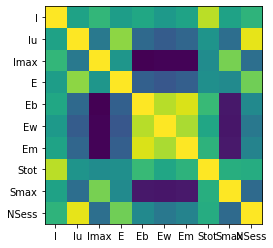

In [42]:
# colored matrix
plt.imshow(cs_no_out.corr())
plt.xticks(range(10), ['I', 'Iu', 'Imax', 'E', 'Eb', 'Ew', 'Em', 'Stot', 'Smax', 'NSess'])
plt.yticks(range(10), ['I', 'Iu', 'Imax', 'E', 'Eb', 'Ew', 'Em', 'Stot', 'Smax', 'NSess'])

### Excluding the highly correlated attributes

Another step of pre-processing is eliminating too correlated features.

This because if different indicators are capturing the same informations this will affects a lot the clusting analysis results.
So we have to select what features are truly useful for clustering analysis.

For this reason, we fix a maximum **threshold** value in order to identify highly correlated features (that, by the way, are well visible in the colored matrix plotted above), and then we drop them.

In [43]:
# threshold value
corr_threshold = 0.9

#highly correlated features list
high_corr_att = []
for i in range(0, len(cs_no_out.columns)):
    for j in range(i+1, len(cs_no_out.columns)):
        corr = cs_no_out[cs_no_out.columns[i]].corr(cs_no_out[cs_no_out.columns[j]])
        if  corr > corr_threshold:
            high_corr_att.append([cs_no_out.columns[i], cs_no_out.columns[j], corr])
high_corr_att

[['I', 'Stot', 0.9206683038304224],
 ['Iu', 'NSess', 0.97159479044453],
 ['Eb', 'Ew', 0.9181532739265861],
 ['Eb', 'Em', 0.9569031648544577],
 ['Ew', 'Em', 0.9032343587542754]]

As a result of this analysis, the indicators that we decided to drob because of too high correlation are: *Eb, Em, Ew* and *Nsess*. In particular, the high value of correlation for the three entropy-based indicators is due to the fact that they were very similar and so they described almost the same kind of informations. Moreover, we had no problem id deleting them since they do not affect too much the clustering process. 

On the countrary, even if the attribute *Stot* is highlited as high correlated with *I*, we decide not to drop it because it is one of the most influent indicator that we have regarding the clustering process (as you will discover below in the radar plot and in the parallel coordinates plot, during k-means validation).

In [44]:
# drop them
cs_corr_columns = ['NSess', "Ew", 'Eb', 'Em']
cs_no_out.drop(cs_corr_columns, axis=1, inplace = True)
cs_no_out

,I,Iu,Imax,E,Stot,Smax
CustomerID,,,,,,
17809.0,304,28,204,4.807355,728.39,560.40
16098.0,435,24,112,4.305245,1107.51,293.14
18074.0,52,8,52,3.000000,185.30,185.30
17420.0,256,23,112,4.483856,485.08,215.76
16250.0,206,21,106,4.349649,373.54,210.24
...,...,...,...,...,...,...
14520.0,12,1,12,0.000000,10.20,10.20
13436.0,69,8,69,3.000000,113.54,113.54
15520.0,194,17,194,4.087463,320.70,320.70


## Normalization
The most common adopted normalizations are: Z-Score and Min-Max.
- The Z-Score normalization approach exploits the mean and standard deviation of data, and tries to center data wrt these two statistical properties.
- The Min-Max normalization approach instead allows to have data that are alwayse interpretable, so that we can avoid to apply inverse transformation.

In the coming analysis we choose to use the Min-Max in order to have a leaner approach because an inverse transformation is not needed.

### Z-Score Normalization

In [45]:
from sklearn.preprocessing import StandardScaler
z_scaler = StandardScaler()
cs_norm_z = z_scaler.fit_transform(cs_no_out.values)

### MinMax Normalization

In [46]:
from sklearn.preprocessing import MinMaxScaler
minmax_scaler = StandardScaler()
cs_norm_minmax = minmax_scaler.fit_transform(cs_no_out.values)

In [47]:
cs_no_out

,I,Iu,Imax,E,Stot,Smax
CustomerID,,,,,,
17809.0,304,28,204,4.807355,728.39,560.40
16098.0,435,24,112,4.305245,1107.51,293.14
18074.0,52,8,52,3.000000,185.30,185.30
17420.0,256,23,112,4.483856,485.08,215.76
16250.0,206,21,106,4.349649,373.54,210.24
...,...,...,...,...,...,...
14520.0,12,1,12,0.000000,10.20,10.20
13436.0,69,8,69,3.000000,113.54,113.54
15520.0,194,17,194,4.087463,320.70,320.70


# Clustering Analysis by K-means

Here we use the ([sklearn](http://scikit-learn.org/stable/modules/clustering.html#k-means)) implementation of the algorithm.

In [48]:
from sklearn.cluster import KMeans

## Identification of the best value of k 
The value of *k* is the input of the algorithm, and it represents exaclty the number of clusters that you want to find. 

Clearly, the definition *a priori* (i.e. not knowing the data) of this number  can be a problem. At the beginning, *k* is chosen randomly: our aim in this context is to fing the best value of *k* by running multiple executions and performing a validation analysis.

In order to do this, we try to perform k-means clustering with different value of *k*, saved below in the array named *max_k*.
So, we pass them as values for the first algorithmic parameter **n_clusters**.

We choose to leave intact the second parameter **n_init**, at its default value equal to 10. It represents the number of time k-means will be run with different initial centroids. The final results will be the best output of these executions, in terms of inertia (i.e. SSE).

Finally, the third parameter **max_iter**, which is the maximum number of iterations of the algorithm for a single run, is set to 100 (default value: 300).

In [49]:
from sklearn.metrics import silhouette_score

max_k = [100, 50, 10, 5] 
sse_values = []
silhouette_values = []

In [50]:
for k in range(2, max_k[0] + 1):
    kmeans = KMeans(n_clusters=k, n_init=10, max_iter=100) # Initializing K-means parameters
    kmeans.fit(cs_norm_minmax) # performing K-means clustering
    #kmeans.fit(cs_norm_z) # performing K-means clustering
    sse_values.append(kmeans.inertia_)
    silhouette_values.append(silhouette_score(cs_norm_minmax, kmeans.labels_))
    #silhouette_values.append(silhouette_score(cs_norm_z, kmeans.labels_))

### Elbow Method
In cluster analysis, the elbow method is a heuristic used in determining the number of clusters *k* in a data set. It consists of plotting the SSE as a function of the number of clusters, and **picking the elbow** of the curve as the number of clusters to use.

Text(0, 0.5, 'SSE')

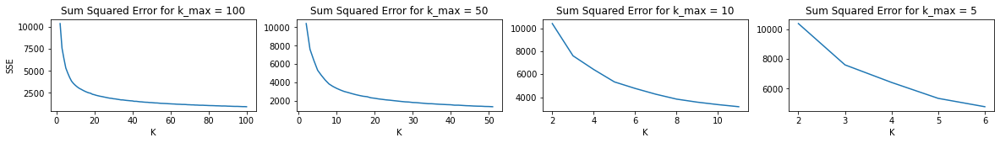

In [51]:
# Create two subplots and unpack the output array immediately
f, axs = plt.subplots(nrows=1, ncols=4, figsize=(20,2))
for i in range(len(max_k)):
    axs[i].plot(range(2, len(sse_values[0:max_k[i]]) + 2), list(sse_values[0:max_k[i]]))
    axs[i].set_title('Sum Squared Error for k_max = ' + str(max_k[i]))
    axs[i].set_xlabel('K')
axs[0].set_ylabel('SSE')

It is easy to see from these plots that the minimum number of clusters after which the value of SSE becomes stable is between 3 and 8 (where the curve creates exacly an "elbow" shape).

### Average Silhouette Method
Here we try another approach to choose the optimal value of *k*, not based on SSE metric as the previous method, but on silhouette.

Text(0, 0.5, 'SIL')

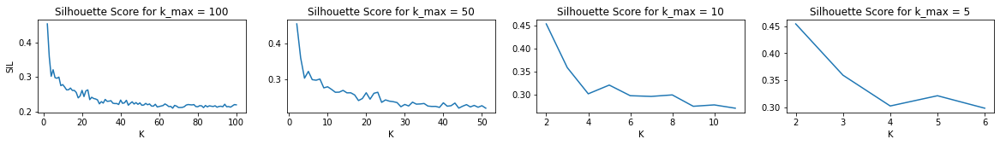

In [52]:
# Create two subplots and unpack the output array immediately
f, axs = plt.subplots(nrows=1, ncols=4, figsize=(20,2))
for i in range(len(max_k)):
    axs[i].plot(range(2, len(silhouette_values[0:max_k[i]]) + 2), silhouette_values[0:max_k[i]])
    axs[i].set_title('Silhouette Score for k_max = ' + str(max_k[i]))
    axs[i].set_xlabel('K')
axs[0].set_ylabel('SIL')

The Average Silhouette method confirms exaclty what was inferred from the Elbow method: the best values for *k* parameter seem to be between 3 and 8.

### Insights from Hierarchical Clustering
Here we try to identify the optimal number of clusters by analysing the hierarchical clustering performed throught the Ward method. <br>Said method aims at the local optimization of the SSE fuction and therefore it is often used in conjunction with K-means.

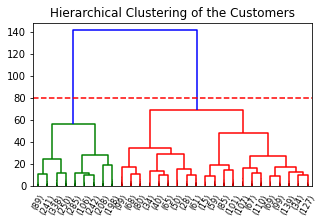

In [53]:
from scipy.cluster.hierarchy import dendrogram, linkage

plt.figure(figsize=(5, 3))
plt.title("Hierarchical Clustering of the Customers")
plt.axhline(y=80, ls='--', c='red')
dend = dendrogram(linkage(cs_norm_minmax, method='ward'), truncate_mode='lastp', p=30, leaf_rotation=60, leaf_font_size = 8, show_contracted=True)

The clustering obtained throught the Ward linkage seems to suggest the presence of two main clusters within the dataset.

### Comparing conclusions
We compare the results obtained previously for those we believe to be the best values for *k*. These are 2, 3, 5, 8.

We will see in the later analysis that the optimal value for *k* will be confirmed to be one of these four.

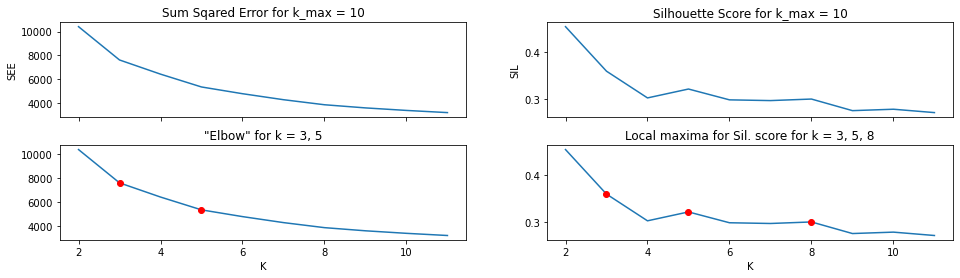

In [54]:
# Create two subplots and unpack the output array immediately
f, axs = plt.subplots(nrows=2, ncols=2, sharex=True, figsize=(16,4))
plt.subplots_adjust(hspace=0.3)
for i in range(2):
    axs[i][0].plot(range(2, len(sse_values[0:max_k[2]]) + 2), sse_values[0:max_k[2]])
    axs[i][1].plot(range(2, len(silhouette_values[0:max_k[2]]) + 2), silhouette_values[0:max_k[2]])

axs[0][0].set_title('Sum Sqared Error for k_max = 10')
axs[0][1].set_title('Silhouette Score for k_max = 10')
axs[0][0].set_ylabel('SEE')
axs[0][1].set_ylabel('SIL')
axs[1][0].set_title('"Elbow" for k = 3, 5')
axs[1][1].set_title('Local maxima for Sil. score for k = 3, 5, 8')
axs[1][0].set_xlabel('K')
axs[1][1].set_xlabel('K')

    
axs[1][0].plot([3], [sse_values[1]], marker='o', c='r')
axs[1][0].plot([5], [sse_values[3]], marker='o', c='r')
axs[1][1].plot([3], [silhouette_values[1]], marker='o', c='r')
axs[1][1].plot([5], [silhouette_values[3]], marker='o', c='r')
axs[1][1].plot([8], [silhouette_values[6]], marker='o', c='r')

## Clustering via K-means for K = 2, 3, 5, 8
Now we run again the k-means algorithm using the three values of *k* that are candidate to be the most appropriate and correct for this data.

In [55]:
Ks = [2, 3, 5, 8]

In [56]:
cs_centers = []
cs_labels = []
cs_inertia = []
for k in Ks:
    kmeans = KMeans(n_clusters=k, n_init=10, max_iter=100)
    kmeans.fit(cs_norm_minmax)
    # kmeans.fit(cs_norm_z) 
    cs_centers.append(minmax_scaler.inverse_transform(kmeans.cluster_centers_))
    # cs_centers = z_scaler.inverse_transform(kmeans.cluster_centers_)
    cs_labels.append(kmeans.labels_)
    cs_inertia.append(kmeans.inertia_)

The output of the algorithm execution will consist in:

* *labels_* of each point
* *cluster\_centers_*: the coordinates of centers
* *inertia_*: sum of squared distances of samples to their closest cluster center.

Then, we add to the numerical features dataset also the categorical features in order to have a complete overview of the customer purchasing behavior dataset. Moreover, we will use these categorical attributes later, to interpret the clustering results.

In [57]:
cs_clusters = cs_no_out.join(cs_cat)
for i in range(len(Ks)):
    cs_clusters['C' + str(Ks[i])] = cs_labels[i]
cs_clusters

,I,Iu,Imax,E,Stot,Smax,Country,Monday,Tuesday,Wednesday,...,September,October,November,December,Weekday,Month,C2,C3,C5,C8
CustomerID,,,,,,,,,,,,,,,,,,,,,
17809.0,304,28,204,4.807355,728.39,560.40,United Kingdom,0.0,13.0,3.0,...,0.0,0.0,3.0,0.0,Tuesday,February,0,0,1,5
16098.0,435,24,112,4.305245,1107.51,293.14,United Kingdom,4.0,37.0,6.0,...,13.0,0.0,0.0,0.0,Tuesday,September,1,0,4,5
18074.0,52,8,52,3.000000,185.30,185.30,United Kingdom,0.0,8.0,0.0,...,0.0,0.0,0.0,0.0,Tuesday,January,1,2,0,2
17420.0,256,23,112,4.483856,485.08,215.76,United Kingdom,0.0,17.0,0.0,...,0.0,8.0,0.0,0.0,Tuesday,June,1,0,4,2
16250.0,206,21,106,4.349649,373.54,210.24,United Kingdom,0.0,13.0,10.0,...,0.0,0.0,0.0,0.0,Tuesday,January,1,2,4,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14520.0,12,1,12,0.000000,10.20,10.20,United Kingdom,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,Friday,August,1,2,0,0
13436.0,69,8,69,3.000000,113.54,113.54,United Kingdom,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,Friday,August,1,2,0,0
15520.0,194,17,194,4.087463,320.70,320.70,United Kingdom,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,Friday,August,1,0,4,5


### Visualization details
The code below is the setting needed to build plots that will be useful to understand the distribution and the nature of the obtained clusters.

In [58]:
visual_labels = [[] for _ in range(len(Ks))]
for i in range(len(Ks)):
    for j in range(1,len(cs_centers[i]) + 1):
        visual_labels[i].append('Cluster ' + str(j))

In [59]:
colors = ['tab:blue', 'tab:orange', 'tab:green', 'tab:red', 'tab:purple', 'tab:brown', 'tab:pink', 'tab:gray', 'tab:olive', 'tab:cyan']
visual_colors = []
for i in range(len(Ks)):
    visual_colors.append(colors[0:Ks[i]])

In [60]:
def autolabel(rects, i = None, j = None):
    if (i != None) and (j!=None): 
        """Attach a text label above each bar in *rects*, displaying its height."""
        for rect in rects:
            height = rect.get_height()
            axs[i][j].annotate('{}'.format(height),
                            xy=(rect.get_x() + rect.get_width() / 2, height),
                            xytext=(0, 3),  # 3 points vertical offset
                            textcoords="offset points",
                            ha='center', va='bottom')
    elif i != None:
        for rect in rects:
            height = rect.get_height()
            axs[i].annotate('{}'.format(height),
                            xy=(rect.get_x() + rect.get_width() / 2, height),
                            xytext=(0, 3),  # 3 points vertical offset
                            textcoords="offset points",
                            ha='center', va='bottom')
    else:
        for rect in rects:
            height = rect.get_height()
            axs.annotate('{}'.format(height),
                            xy=(rect.get_x() + rect.get_width() / 2, height),
                            xytext=(0, 3),  # 3 points vertical offset
                            textcoords="offset points",
                            ha='center', va='bottom')

## Characterization of the obtained clusters
We are now ready to build different plots to have a complete picture of clusters composition and population, so that we can fully understand and interprete the results given by the k-means algorithm.

In particular, we will perform a full and exaustive analysis for each single case, that is for *k* = 3, 5 and 8.

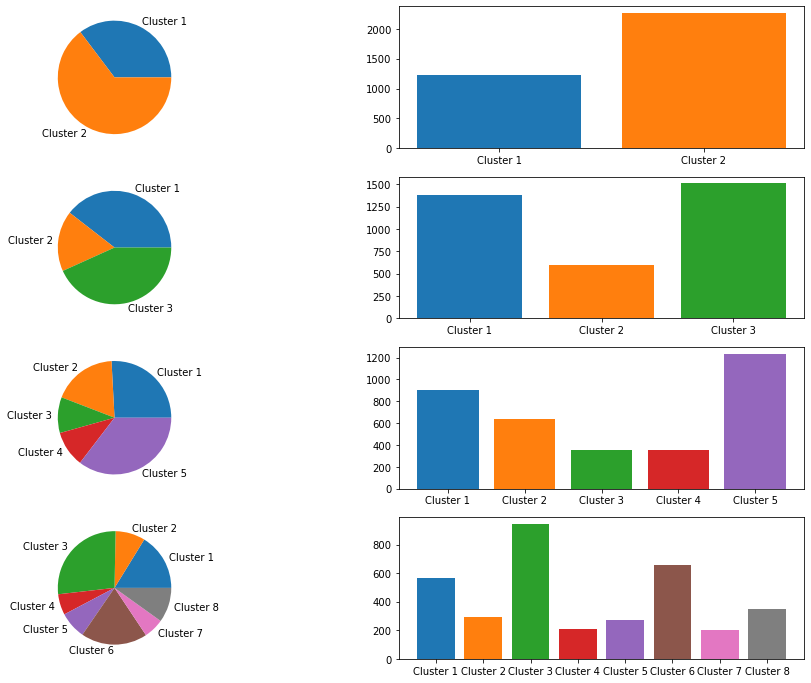

In [61]:
f, axs = plt.subplots(nrows=len(Ks), ncols=2, figsize=(16,12))
for i in range(len(Ks)):
    hist, bins = np.histogram(cs_labels[i], bins=range(0, len(set(cs_labels[i])) + 1))
    axs[i][0].pie(hist, labels=visual_labels[i])
    axs[i][1].bar(list(range(0,len(set(cs_labels[i])))), hist, color=visual_colors[i], tick_label=visual_labels[i])

The pie charts on the left column and the barplots on the right one are the visualization of the distribution of k-means results with, respectively, 3, 5 and 8 clusters. 

For each label assigned, you can easily see how the population for each cluster, in all the thee cases, is distributed and proportioned.

### K = 2
We now highlight again the cluster distribution for the case *k* = 2.

In addiction to this distribution visualization, we are going to call back again each single categorical feature to make a complete interpretation of the two clusters.

#### Clusters distributions: Pie Chart and Histogram

In [62]:
hist, bins = np.histogram(cs_labels[0], bins=range(0, len(set(cs_labels[0])) + 1))

<BarContainer object of 2 artists>

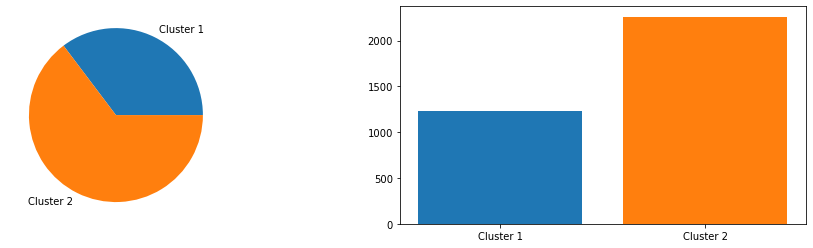

In [63]:
f, axs = plt.subplots(nrows=1, ncols=2, figsize=(16,4))
axs[0].pie(hist, labels=visual_labels[0])
axs[1].bar(list(range(1,Ks[0]+1)), hist, color=visual_colors[0], tick_label=visual_labels[0])

#### Classification via categorical attributes
Now we bring up those categorical lables that were excluded from the cluster building process, in order to understand and interpret the  results of k-means algorithm.

##### Clusters by Country
Here we consider the *Country* attribute and we build plots in order to understand how clusters are distributed with respect to this lable. 

The first plot highlights the already known predominancy of United Kingdoms over all other countries, as discovered also during the Data Understanding and Preparation phases. As a matter of fact, here this predominancy is confirmed and clearly visible on the fact that most of the population (for all the three clusters) is made by customers that made purchses from UK. 

Then, the other three plots focus on the other countries and their distribution within the three clusters.

We have chosen this split (UK vs other countries) in order to have plots that are as clear as possible and also to improve data visualization.

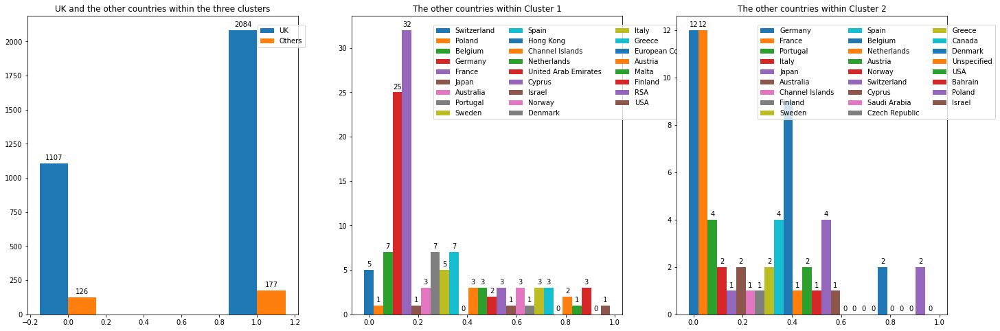

In [64]:
UK_bar = cs_clusters[cs_clusters.Country == 'United Kingdom'].groupby(['C2', 'Country']).size().unstack()
UK_bar['Others'] = pd.DataFrame(cs_clusters[cs_clusters.Country != 'United Kingdom'].groupby(['C2']).size())

other_countries = [[] for _ in range(Ks[0])]
other_values = [[] for _ in range(Ks[0])]
for cluster in range(Ks[0]):
    for country in cs_clusters[(cs_clusters.Country != 'United Kingdom') & (cs_clusters.C2 == cluster)].Country.unique():
        other_countries[cluster].append(country)
        other_values[cluster].append(cs_clusters[(cs_clusters.C3 == cluster) & (cs_clusters.Country == country)].Country.count())

x = np.arange(len(visual_labels[0]))
width = 0.15

f, axs = plt.subplots(nrows=1, ncols=3, figsize=(24,8))
autolabel(axs[0].bar(x - width/2, UK_bar['United Kingdom'], width, label='UK'), 0)
autolabel(axs[0].bar(x + width/2, UK_bar['Others'], width, label='Others'), 0)
axs[0].legend(bbox_to_anchor=(0.85, 0.97), loc='upper left', borderaxespad=0.)
axs[0].set_title('UK and the other countries within the three clusters')

for i in [1,2]:
    for j in range(len(other_countries[i-1])):
        point = (1/len(other_countries[1-1])*j)
        autolabel(axs[i].bar( point, other_values[i-1][j], (1/len(other_countries[i-1])), label=other_countries[i-1][j]), i)
        axs[i].legend(bbox_to_anchor=(0.3, 0.97), loc='upper left', borderaxespad=0., ncol=3)
    axs[i].set_title('The other countries within Cluster '+ str(i))
    

We can interpet these distribution saying that, for all the three clusters, the majority of purchases is made by customers coming from France and Germany, but also from Belgium and Spain.

##### Clusters by Weekday
We now focus on the clusters distribution with respect to the *weekday* categorical feature, in order to understand if customers are grouped together on the basis on which day of the week they make purchases.

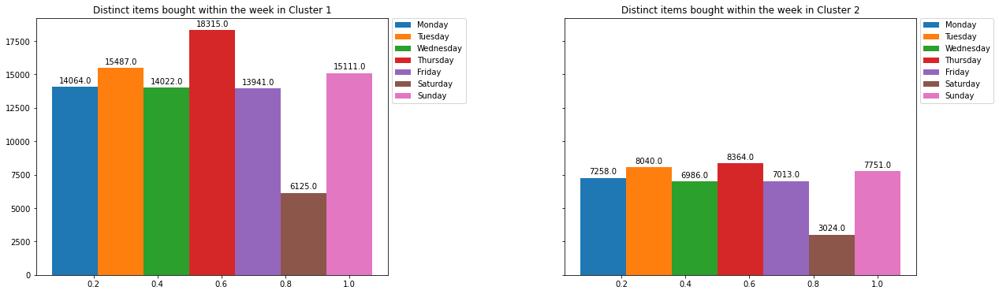

In [65]:
weekdays_bar = [[] for _ in range(Ks[0])]
for j in range(Ks[0]):
    for i in range(1,8):
        weekdays_bar[j].append(cs_clusters[cs_clusters.C2 == j][cs_cat.columns[i]].sum())

f, axs = plt.subplots(nrows=1, ncols=2, figsize=(20,6), sharey=True)
f.subplots_adjust(wspace=0.5)

for j in range(Ks[0]):
    for i in range(1,8):
        point = (1/len(weekdays_bar[j]) * i)
        autolabel(axs[j].bar(point, weekdays_bar[j][i-1], 1/len(weekdays_bar[j]), label=cs_cat.columns[i]), j)
    axs[j].legend(bbox_to_anchor=(1.01, 1), loc='upper left', borderaxespad=0.)
    axs[j].set_title('Distinct items bought within the week in Cluster ' + str(j+1))



It is pretty clear that, among all the three clusters, that the customers' favourite days for doing shopping are Thursday and Sunday.

##### Clusters by Month
Again, we perform the same analysis based on *month* categorical attribute, in order to understand if, in the clusters resulting from the algorithm, customers are grouped together on the basis of which month is the best for them to make purchases.

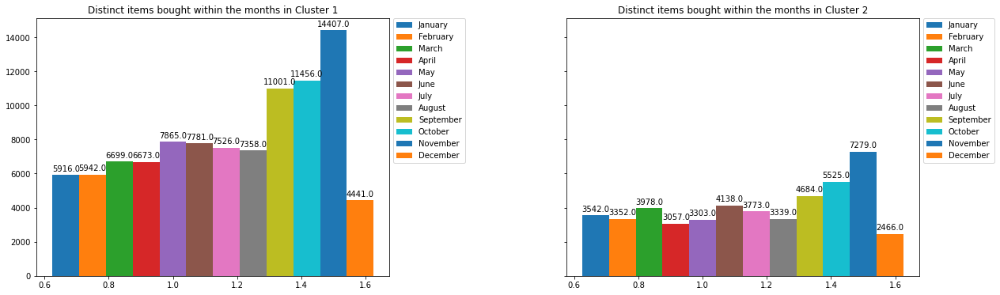

In [66]:
months_bar = [[] for _ in range(Ks[0])]
for j in range(Ks[0]):
    for i in range(8,20):
        months_bar[j].append(cs_clusters[cs_clusters.C2 == j][cs_cat.columns[i]].sum())
        
f, axs = plt.subplots(nrows=1, ncols=2, figsize=(20,6), sharey=True)
f.subplots_adjust(wspace=0.5)

for j in range(Ks[0]):
    for i in range(8,20):
        point = (1/len(months_bar[j]) * i)
        autolabel(axs[j].bar(point, months_bar[j][i-8], 1/len(months_bar[j]), label=cs_cat.columns[i]), j)
    axs[j].legend(bbox_to_anchor=(1.01, 1), loc='upper left', borderaxespad=0.)
    axs[j].set_title('Distinct items bought within the months in Cluster ' + str(j+1))

It is evident that clusters corresponding to fall months (September, October, but mostly November) are representing the favourite periods of the year fot the customers to make purchases.

#### Analysis of the centroids
We now exploit the bidimensional visualization to have a global view, and so we build scatter plots for all the pairs of correlations between features (to avoid repetition and redundant informations, we decided to print only what was above the main diagonal of the correlation matrix).  

Here you can clearly see the cluster separation and assignment in different colors, and also the centroids in red, so that is is immediate to understand and visualize where the center (i.e. the average value) is located for any cluster.


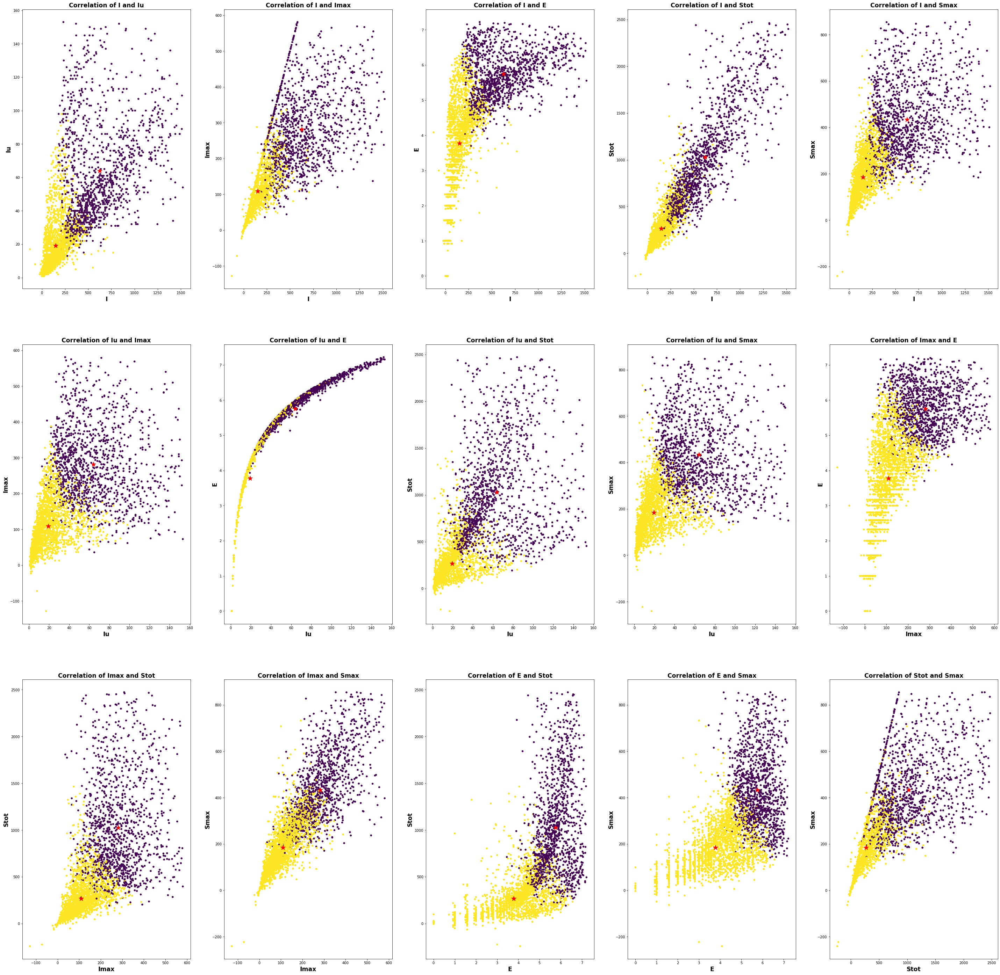

In [67]:
# scatter plots with centroids
f, axs = plt.subplots(nrows=3, ncols=5, figsize=(50,50))
index = 0
for i in range(0,len(cs_no_out.columns)):
    for j in range(i+1,len(cs_no_out.columns)):
        axs[int(index/5)][index%5].scatter(cs_no_out[cs_no_out.columns[i]], cs_no_out[cs_no_out.columns[j]], c=cs_labels[0], s=20)
        for h in range(len(cs_centers[0])):
            axs[int(index/5)][index%5].scatter(cs_centers[0][h][i], cs_centers[0][h][j], s=200, marker='*', c='r')
        axs[int(index/5)][index%5].set_title('Correlation of ' + cs_no_out.columns[i] + ' and ' + cs_no_out.columns[j], fontdict={'fontsize': 'xx-large', 'fontweight' : 'bold'})
        axs[int(index/5)][index%5].set_xlabel(cs_no_out.columns[i], fontdict={'fontsize': 'xx-large', 'fontweight' : 'bold'})
        axs[int(index/5)][index%5].set_ylabel(cs_no_out.columns[j], fontdict={'fontsize': 'xx-large', 'fontweight' : 'bold'})
        index = index + 1

It is easy to see that cluster are well separated and there is no troble with points overlapping. 

However, this statement alone is not enough because it is only based on data visualization. It will be confirmed in a stronger way later, with evaluation metrics.

#### Radar plot
The radar plot is a really powerful tool for clustering analysis, as well as the parallel coordinates plot below.

In them we have the list of attributes and for any centroid we report the value of the corresponding feature. 
In this way we are able to analyze what attribute is better representing clusters.

C:\Users\Diletta\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:13: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  del sys.path[0]


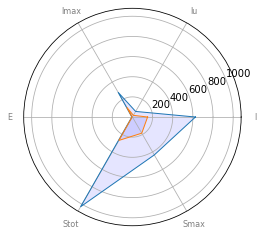

In [68]:
# centroids visualization via radar chart
from math import pi
 
# number of variable
N = len(cs_no_out.columns)
# What will be the angle of each axis in the plot? (we divide the plot / number of variable)
for i in range(0, len(cs_centers[0])):
    angles = [n / float(N) * 2 * pi for n in range(N)]
    values = cs_centers[0][i].tolist()
    values += values[:1]
    angles += angles[:1]
    # Initialise the spider plot
    ax = plt.subplot(polar=True)
# Draw one axe per variable + add labels labels yet
    plt.xticks(angles[:-1], cs_no_out.columns, color='grey', size=8) 
# Plot data
    ax.plot(angles, values, linewidth=1, linestyle='solid')
 # Fill area
    ax.fill(angles, values, 'b', alpha=0.1)

#### Parallel Coordinates

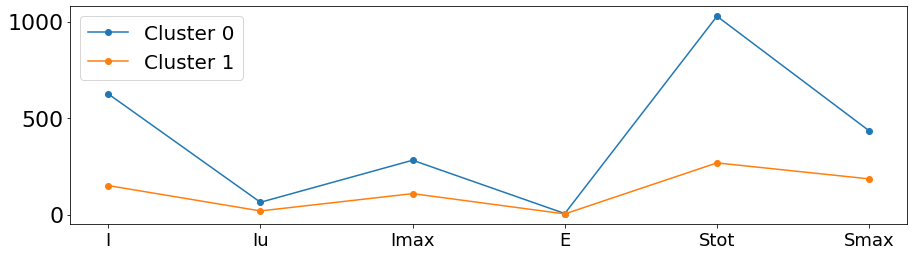

In [69]:
plt.figure(figsize=(15, 4))
for i in range(0, len(cs_centers[0])):
    plt.plot(cs_centers[0][i], marker='o', label='Cluster %s' % i)
plt.tick_params(axis='both', which='major', labelsize=22)
plt.xticks(range(0, len(cs_no_out.columns)), cs_no_out.columns, fontsize=18)
plt.legend(fontsize=20)
plt.show()

What emerges from both plots is that ***I* and *Stot* are the most relevant features for this clustering process** (in particular, cluster 1 is that with the highest value of *Stot* attribute). That's why we decided not to drop *Stot* when the high-correlation analysis suggested that it was above the maximum threshold.

This information is really useful because, in our purpose of clustering results interpretation, **we can conclude that clusters are actually grouped representing how much customers are buying, with respect to both quantity and expenditure.**

### K = 3
We now highlight again the cluster distribution for the case *k* = 3, since it is confirmed to be the optimal value for the parameter *k* in k-means algorithm.

*Motivare perchè k=3 è il valore ottimale.*

In addiction to this distribution visualization, we are going to call back again each single categorical feature to make a complete interpretation of the three clusters.

#### Clusters distributions: Pie Chart and Histogram

In [70]:
hist, bins = np.histogram(cs_labels[1], bins=range(0, len(set(cs_labels[1])) + 1))

<BarContainer object of 3 artists>

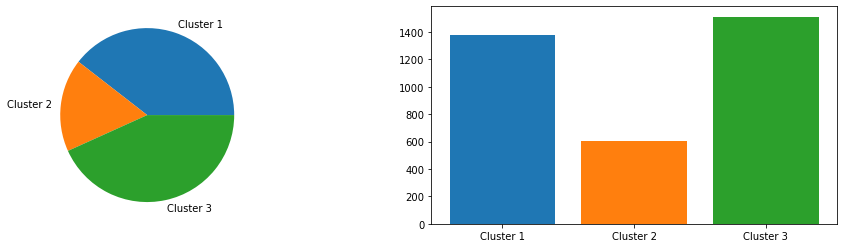

In [71]:
f, axs = plt.subplots(nrows=1, ncols=2, figsize=(16,4))
axs[0].pie(hist, labels=visual_labels[1])
axs[1].bar(list(range(1,Ks[1]+1)), hist, color=visual_colors[1], tick_label=visual_labels[1])

#### Classification via categorical attributes
Now we bring up those categorical lables that were excluded from the cluster building process, in order to understand and interpret the  results of k-means algorithm.

##### Clusters by Country
Here we consider the *Country* attribute and we build plots in order to understand how clusters are distributed with respect to this lable. 

The first plot highlights the already known predominancy of United Kingdoms over all other countries, as discovered also during the Data Understanding and Preparation phases. As a matter of fact, here this predominancy is confirmed and clearly visible on the fact that most of the population (for all the three clusters) is made by customers that made purchses from UK. 

Then, the other three plots focus on the other countries and their distribution within the three clusters.

We have chosen this split (UK vs other countries) in order to have plots that are as clear as possible and also to improve data visualization.

Text(0.5, 1.0, 'The other countries within the third cluster')

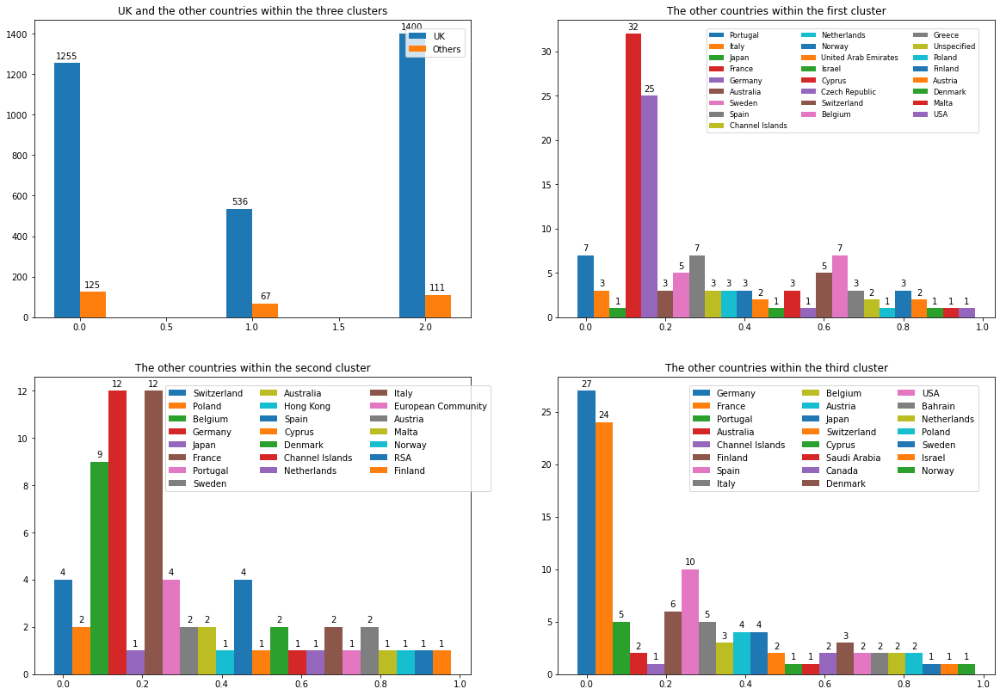

In [72]:
UK_bar = cs_clusters[cs_clusters.Country == 'United Kingdom'].groupby(['C3', 'Country']).size().unstack()
UK_bar['Others'] = pd.DataFrame(cs_clusters[cs_clusters.Country != 'United Kingdom'].groupby(['C3']).size())

other_countries = [[] for _ in range(Ks[1])]
other_values = [[] for _ in range(Ks[1])]
for cluster in range(Ks[1]):
    for country in cs_clusters[(cs_clusters.Country != 'United Kingdom') & (cs_clusters.C3 == cluster)].Country.unique():
        other_countries[cluster].append(country)
        other_values[cluster].append(cs_clusters[(cs_clusters.C3 == cluster) & (cs_clusters.Country == country)].Country.count())

x = np.arange(len(visual_labels[1]))
width = 0.15

f, axs = plt.subplots(nrows=2, ncols=2, figsize=(20,14))
autolabel(axs[0][0].bar(x - width/2, UK_bar['United Kingdom'], width, label='UK'), 0, 0)
autolabel(axs[0][0].bar(x + width/2, UK_bar['Others'], width, label='Others'), 0 ,0)
axs[0][0].legend(bbox_to_anchor=(0.85, 0.97), loc='upper left', borderaxespad=0.)
axs[0][0].set_title('UK and the other countries within the three clusters')

for j in range(len(other_countries[0])):
    point = (1/len(other_countries[0]) * j)
    autolabel(axs[0][1].bar(point, other_values[0][j], (1/len(other_countries[0])), label=other_countries[0][j]), 0, 1)
axs[0][1].legend(bbox_to_anchor=(0.34, 0.97), loc='upper left', borderaxespad=0., ncol=3, fontsize='small')
axs[0][1].set_title('The other countries within the first cluster')

for i in [0,1]:
    for j in range(len(other_countries[i+1])):
        point = (1/len(other_countries[1+i]) * j)
        autolabel(axs[1][i].bar( point, other_values[1+i][j], (1/len(other_countries[1+i])), label=other_countries[1+i][j]), 1, i)
        axs[1][i].legend(bbox_to_anchor=(0.3, 0.97), loc='upper left', borderaxespad=0., ncol=3)
axs[1][0].set_title('The other countries within the second cluster')
axs[1][1].set_title('The other countries within the third cluster')

We can interpet these distribution saying that, for all the three clusters, the majority of purchases is made by customers coming from France and Germany, but also from Belgium and Spain.

##### Clusters by Weekday
We now focus on the clusters distribution with respect to the *weekday* categorical feature, in order to understand if customers are grouped together on the basis on which day of the week they make purchases.

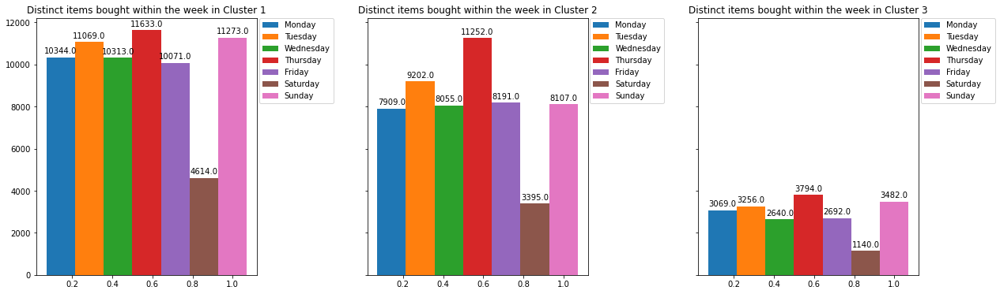

In [73]:
weekdays_bar = [[] for _ in range(Ks[1])]
for j in range(Ks[1]):
    for i in range(1,8):
        weekdays_bar[j].append(cs_clusters[cs_clusters.C3 == j][cs_cat.columns[i]].sum())

f, axs = plt.subplots(nrows=1, ncols=3, figsize=(20,6), sharey=True)
f.subplots_adjust(wspace=0.5)

for j in range(Ks[1]):
    for i in range(1,8):
        point = (1/len(weekdays_bar[j]) * i)
        autolabel(axs[j].bar(point, weekdays_bar[j][i-1], 1/len(weekdays_bar[j]), label=cs_cat.columns[i]), j)
    axs[j].legend(bbox_to_anchor=(1.01, 1), loc='upper left', borderaxespad=0.)
    axs[j].set_title('Distinct items bought within the week in Cluster ' + str(j+1))

It is pretty clear that, among all the three clusters, that the customers' favourite days for doing shopping are Thursday and Sunday.

##### Clusters by Month
Again, we perform the same analysis based on *month* categorical attribute, in order to understand if, in the clusters resulting from the algorithm, customers are grouped together on the basis of which month is the best for them to make purchases.

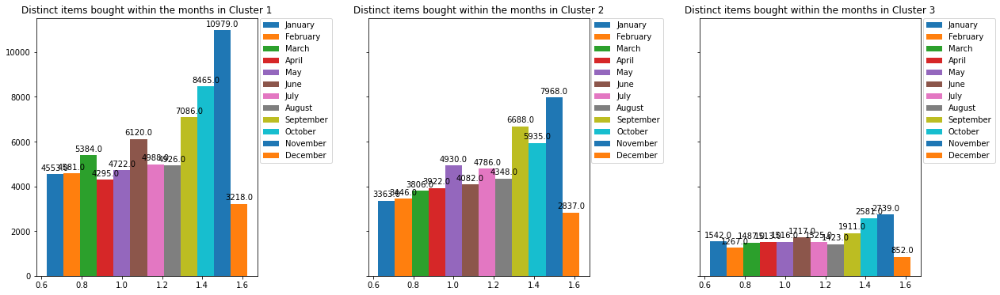

In [74]:
months_bar = [[] for _ in range(Ks[1])]
for j in range(Ks[1]):
    for i in range(8,20):
        months_bar[j].append(cs_clusters[cs_clusters.C3 == j][cs_cat.columns[i]].sum())
        
f, axs = plt.subplots(nrows=1, ncols=3, figsize=(20,6), sharey=True)
f.subplots_adjust(wspace=0.5)

for j in range(Ks[1]):
    for i in range(8,20):
        point = (1/len(months_bar[j]) * i)
        autolabel(axs[j].bar(point, months_bar[j][i-8], 1/len(months_bar[j]), label=cs_cat.columns[i]), j)
    axs[j].legend(bbox_to_anchor=(1.01, 1), loc='upper left', borderaxespad=0.)
    axs[j].set_title('Distinct items bought within the months in Cluster ' + str(j+1))

It is evident that clusters corresponding to fall months (September, October, but mostly November) are representing the favourite periods of the year fot the customers to make purchases.

#### Analysis of the centroids
We now exploit the bidimensional visualization to have a global view, and so we build scatter plots for all the pairs of correlations between features (to avoid repetition and redundant informations, we decided to print only what was above the main diagonal of the correlation matrix).  

Here you can clearly see the cluster separation and assignment in different colors, and also the centroids in red, so that is is immediate to understand and visualize where the center (i.e. the average value) is located for any cluster.


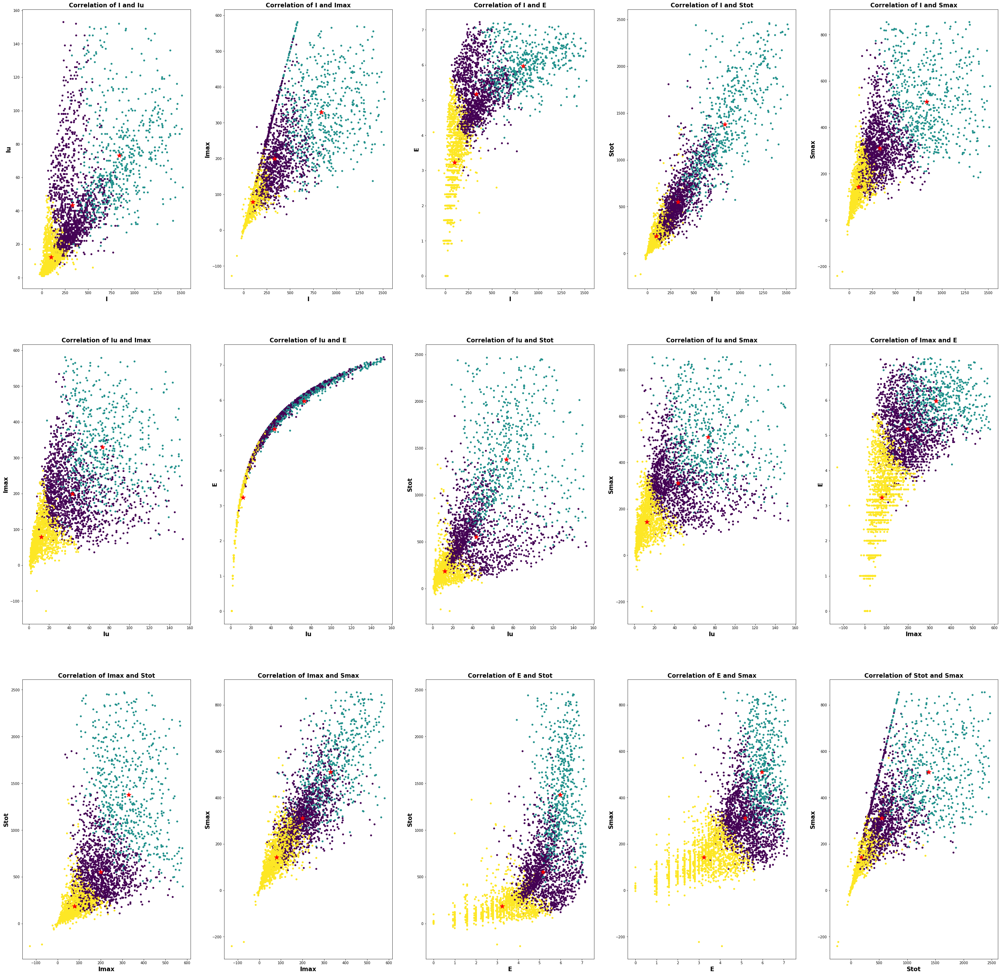

In [75]:
# scatter plots with centroids
f, axs = plt.subplots(nrows=3, ncols=5, figsize=(50,50))
index = 0
for i in range(0,len(cs_no_out.columns)):
    for j in range(i+1,len(cs_no_out.columns)):
        axs[int(index/5)][index%5].scatter(cs_no_out[cs_no_out.columns[i]], cs_no_out[cs_no_out.columns[j]], c=cs_labels[1], s=20)
        for h in range(len(cs_centers[1])):
            axs[int(index/5)][index%5].scatter(cs_centers[1][h][i], cs_centers[1][h][j], s=200, marker='*', c='r')
        axs[int(index/5)][index%5].set_title('Correlation of ' + cs_no_out.columns[i] + ' and ' + cs_no_out.columns[j], fontdict={'fontsize': 'xx-large', 'fontweight' : 'bold'})
        axs[int(index/5)][index%5].set_xlabel(cs_no_out.columns[i], fontdict={'fontsize': 'xx-large', 'fontweight' : 'bold'})
        axs[int(index/5)][index%5].set_ylabel(cs_no_out.columns[j], fontdict={'fontsize': 'xx-large', 'fontweight' : 'bold'})
        index = index + 1

It is easy to see that cluster are well separated and there is no troble with points overlapping. 

However, this statement alone is not enough because it is only based on data visualization. It will be confirmed in a stronger way later, with evaluation metrics.

#### Radar plot
The radar plot is a really powerful tool for clustering analysis, as well as the parallel coordinates plot below.

In them we have the list of attributes and for any centroid we report the value of the corresponding feature. 
In this way we are able to analyze what attribute is better representing clusters.

C:\Users\Diletta\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:13: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  del sys.path[0]


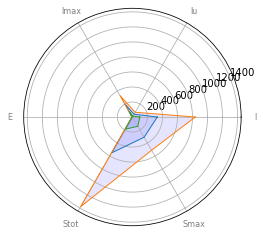

In [76]:
# centroids visualization via radar chart
from math import pi
 
# number of variable
N = len(cs_no_out.columns)
# What will be the angle of each axis in the plot? (we divide the plot / number of variable)
for i in range(0, len(cs_centers[1])):
    angles = [n / float(N) * 2 * pi for n in range(N)]
    values = cs_centers[1][i].tolist()
    values += values[:1]
    angles += angles[:1]
    # Initialise the spider plot
    ax = plt.subplot(polar=True)
# Draw one axe per variable + add labels labels yet
    plt.xticks(angles[:-1], cs_no_out.columns, color='grey', size=8) 
# Plot data
    ax.plot(angles, values, linewidth=1, linestyle='solid')
 # Fill area
    ax.fill(angles, values, 'b', alpha=0.1)

#### Parallel Coordinates

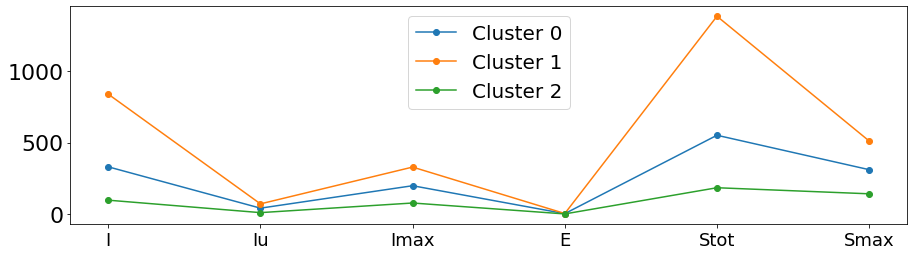

In [77]:
plt.figure(figsize=(15, 4))
for i in range(0, len(cs_centers[1])):
    plt.plot(cs_centers[1][i], marker='o', label='Cluster %s' % i)
plt.tick_params(axis='both', which='major', labelsize=22)
plt.xticks(range(0, len(cs_no_out.columns)), cs_no_out.columns, fontsize=18)
plt.legend(fontsize=20)
plt.show()

What emerges from both plots is that ***I* and *Stot* are the most relevant features for this clustering process** (in particular, cluster 1 is that with the highest value of *Stot* attribute). That's why we decided not to drop *Stot* when the high-correlation analysis suggested that it was above the maximum threshold.

This information is really useful because, in our purpose of clustering results interpretation, **we can conclude that clusters are actually grouped representing how much customers are buying, with respect to both quantity and expenditure.**

### K = 5
We now highlight again the cluster distribution for the case of *k* = 5.

In addiction to this distribution visualization, we are going to call back again each single categorical feature to make a complete interpretation of these five clusters.

#### Clusters distributions: Pie Chart and Histogram

In [78]:
hist, bins = np.histogram(cs_labels[2], bins=range(0, len(set(cs_labels[2])) + 1))

<BarContainer object of 5 artists>

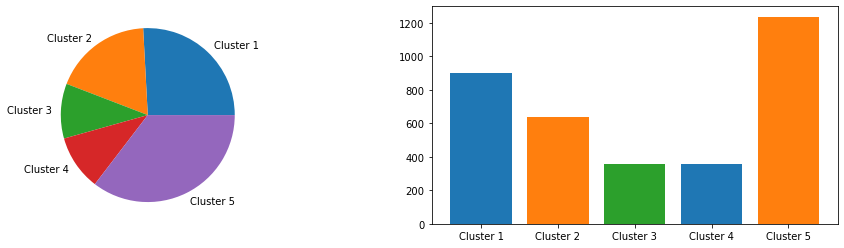

In [79]:
f, axs = plt.subplots(nrows=1, ncols=2, figsize=(16,4))
axs[0].pie(hist, labels=visual_labels[2])
axs[1].bar(list(range(1, Ks[2]+1)), hist, color=visual_colors[1], tick_label=visual_labels[2])

#### Classification via categorical attributes
Now we bring up those categorical lables that were excluded from the cluster building process, in order to understand and interpret the  results of k-means algorithm.

##### Clusters by Country
Here we consider the *Country* attribute and we build plots in order to understand how clusters are distributed with respect to this lable. 

The first plot highlights the already known predominancy of United Kingdoms over all other countries, as discovered also during the Data Understanding and Preparation phases. As a matter of fact, here this predominancy is confirmed and clearly visible on the fact that most of the population (for all the five clusters) is made by customers that made purchses from UK. 

Text(0.5, 1.0, 'UK and the other countries within the three clusters')

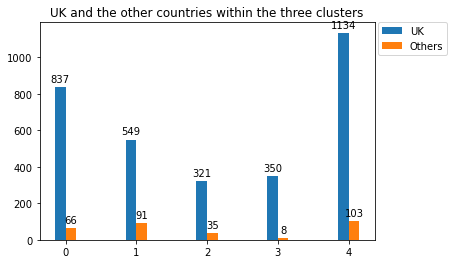

In [80]:
UK_bar = cs_clusters[cs_clusters.Country == 'United Kingdom'].groupby(['C5', 'Country']).size().unstack()
UK_bar['Others'] = pd.DataFrame(cs_clusters[cs_clusters.Country != 'United Kingdom'].groupby(['C5']).size())

other_countries = [[] for _ in range(Ks[2])]
other_values = [[] for _ in range(Ks[2])]
for cluster in range(Ks[2]):
    for country in cs_clusters[(cs_clusters.Country != 'United Kingdom') & (cs_clusters.C5 == cluster)].Country.unique():
        other_countries[cluster].append(country)
        other_values[cluster].append(cs_clusters[(cs_clusters.C5 == cluster) & (cs_clusters.Country == country)].Country.count())

x = np.arange(len(visual_labels[2]))
width = 0.15

f, axs = plt.subplots(nrows=1, ncols=1)
autolabel(axs.bar(x - width/2, UK_bar['United Kingdom'], width, label='UK'))
autolabel(axs.bar(x + width/2, UK_bar['Others'], width, label='Others'))
axs.legend(bbox_to_anchor=(1.01, 1), loc='upper left', borderaxespad=0.)
axs.set_title('UK and the other countries within the three clusters')

Then, the other five plots focus on the other countries and their distribution within the five clusters.

As we did before, we have chosen this split (UK vs other countries) in order to have plots that are as clear as possible and also to improve data visualization.

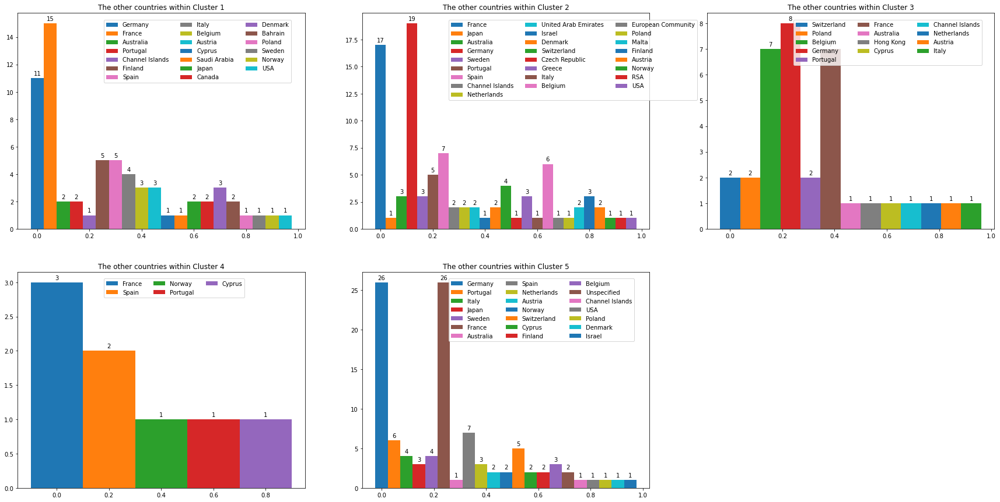

In [81]:
f, axs = plt.subplots(nrows=2, ncols=3, figsize=(30,15))


for i in [0,1]:
    for j in [0,1,2]:
        if i == 1 and j == 2 : 
            break
        for c in range(len(other_countries[i*3 + j])):
            point = (1/len(other_countries[i*3 + j]) * c)
            autolabel(axs[i][j].bar( point, other_values[i*3 + j][c], (1/len(other_countries[i*3 + j])), label=other_countries[i*3 + j][c]), i, j)
            axs[i][j].legend(bbox_to_anchor=(0.3, 0.97), loc='upper left', borderaxespad=0., ncol=3)
        axs[i][j].set_title('The other countries within Cluster ' + str(i*3 + j + 1))
axs[1][2].remove()

As confirmation of the distribution analysis made by *Country* feature in the previous case of three clusters, also here the majority of purchases is made by customers coming from the same countries: France, Germany, Belgium and Spain.

##### Clusters by Weekday
We now focus on the clusters distribution with respect to the *weekday* categorical feature, in order to understand if customers are grouped together on the basis on which day of the week they make purchases.

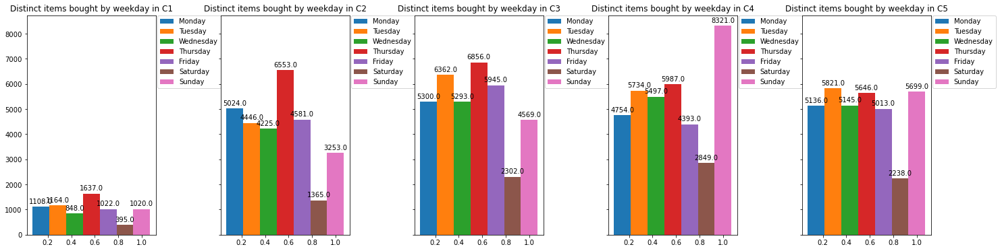

In [82]:
weekdays_bar = [[] for _ in range(Ks[2])]
for j in range(Ks[2]):
    for i in range(1,8):
        weekdays_bar[j].append(cs_clusters[cs_clusters.C5 == j][cs_cat.columns[i]].sum())

f, axs = plt.subplots(nrows=1, ncols=Ks[2], figsize=(24,6), sharey=True)
f.subplots_adjust(wspace=0.5)

for j in range(Ks[2]):
    for i in range(1,8):
        point = (1/len(weekdays_bar[j]) * i)
        autolabel(axs[j].bar(point, weekdays_bar[j][i-1], 1/len(weekdays_bar[j]), label=cs_cat.columns[i]), j)
    axs[j].legend(bbox_to_anchor=(1.01, 1), loc='upper left', borderaxespad=0.)
    axs[j].set_title('Distinct items bought by weekday in C' + str(j+1))

As confirmation of the distribution analysis made by *Weekday* feature in the previous case of three clusters, also here it is evident that, among all the five clusters, that the customers' favourite days for doing shopping are Sunday (for cluster 1) and Thursday (for clusters 3, 4 and 5).

##### Clusters by Month
Again, we perform the same analysis based on *month* categorical attribute, in order to understand if, in the clusters resulting from the algorithm, customers are grouped together on the basis of which month is the best for them to make purchases.

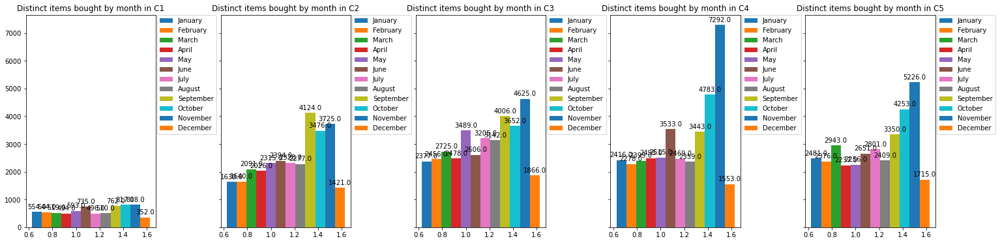

In [83]:
months_bar = [[] for _ in range(Ks[2])]
for j in range(Ks[2]):
    for i in range(8,20):
        months_bar[j].append(cs_clusters[cs_clusters.C5 == j][cs_cat.columns[i]].sum())
        
f, axs = plt.subplots(nrows=1, ncols=Ks[2], figsize=(25,6), sharey=True)
f.subplots_adjust(wspace=0.5)

for j in range(Ks[2]):
    for i in range(8,20):
        point = (1/len(months_bar[j]) * i)
        autolabel(axs[j].bar(point, months_bar[j][i-8], 1/len(months_bar[j]), label=cs_cat.columns[i]), j)
    axs[j].legend(bbox_to_anchor=(1.01, 1), loc='upper left', borderaxespad=0.)
    axs[j].set_title('Distinct items bought by month in C' + str(j+1))

As confirmation of the distribution analysis made by *Month* feature in the previous case of three clusters, also here it is evident that clusters corresponding to fall months (September, October, but mostly November) are representing the favourite periods of the year fot the customers to make purchases.

#### Analysis of the centroids
We again exploit the bidimensional visualization to have a global view, and so we build scatter plots for all the pairs of correlations between features (to avoid repetition and redundant informations, we decided to print only what was above the main diagonal of the correlation matrix).  

Here you can clearly see the cluster separation and assignment in different colors, and also the centroids in red, so that is is immediate to understand and visualize where the center (i.e. the average value) is located for any cluster.

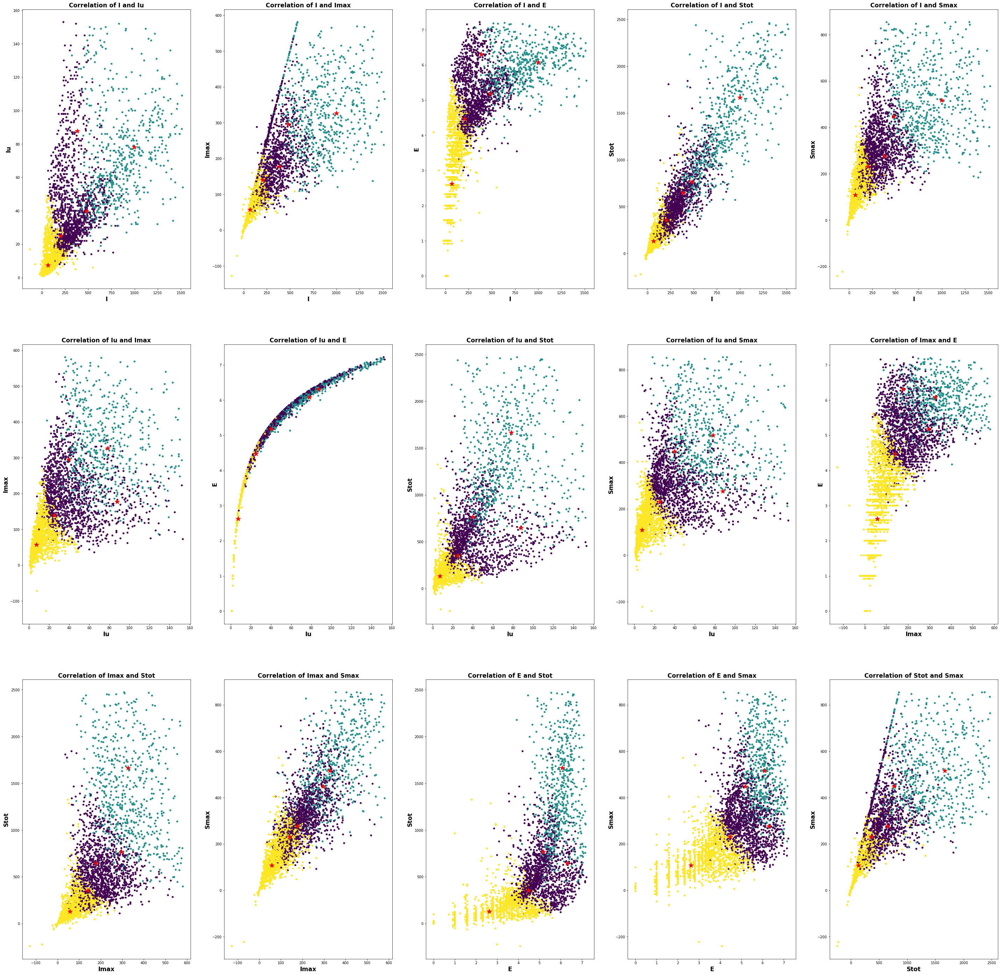

In [84]:
# scatter plots with centroids
f, axs = plt.subplots(nrows=3, ncols=5, figsize=(50,50))
index = 0
for i in range(0,len(cs_no_out.columns)):
    for j in range(i+1,len(cs_no_out.columns)):
        axs[int(index/5)][index%5].scatter(cs_no_out[cs_no_out.columns[i]], cs_no_out[cs_no_out.columns[j]], c=cs_labels[1], s=20)
        for h in range(len(cs_centers[2])):
            axs[int(index/5)][index%5].scatter(cs_centers[2][h][i], cs_centers[2][h][j], s=200, marker='*', c='r')
        axs[int(index/5)][index%5].set_title('Correlation of ' + cs_no_out.columns[i] + ' and ' + cs_no_out.columns[j], fontdict={'fontsize': 'xx-large', 'fontweight' : 'bold'})
        axs[int(index/5)][index%5].set_xlabel(cs_no_out.columns[i], fontdict={'fontsize': 'xx-large', 'fontweight' : 'bold'})
        axs[int(index/5)][index%5].set_ylabel(cs_no_out.columns[j], fontdict={'fontsize': 'xx-large', 'fontweight' : 'bold'})
        index = index + 1

It is not difficult to see that the the previous case of *k*=3 was better w.r.t visual representation, because clusters were better separated and there was not so much overlapping of points. 

Also from this evidence (but in addiction with the stronger confirmation of evaluation metrics results) we are able to say that 3 is the best value as number of cluster of k-means algorithm.

#### Radar plot
Again, with radar plots and parallel coordinates plot, for any centroid we report the value of the corresponding feature. In this way we are able to analyze what attribute is better representing clusters.

C:\Users\Diletta\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:13: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  del sys.path[0]


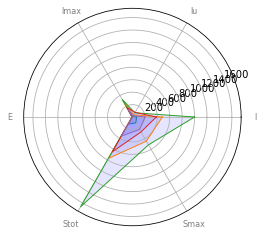

In [85]:
# centroids visualization via radar chart
from math import pi
 
# number of variable
N = len(cs_no_out.columns)
# What will be the angle of each axis in the plot? (we divide the plot / number of variable)
for i in range(0, len(cs_centers[2])):
    angles = [n / float(N) * 2 * pi for n in range(N)]
    values = cs_centers[2][i].tolist()
    values += values[:1]
    angles += angles[:1]
    # Initialise the spider plot
    ax = plt.subplot(polar=True)
# Draw one axe per variable + add labels labels yet
    plt.xticks(angles[:-1], cs_no_out.columns, color='grey', size=8) 
# Plot data
    ax.plot(angles, values, linewidth=1, linestyle='solid')
 # Fill area
    ax.fill(angles, values, 'b', alpha=0.1)

#### Parallel Coordinates

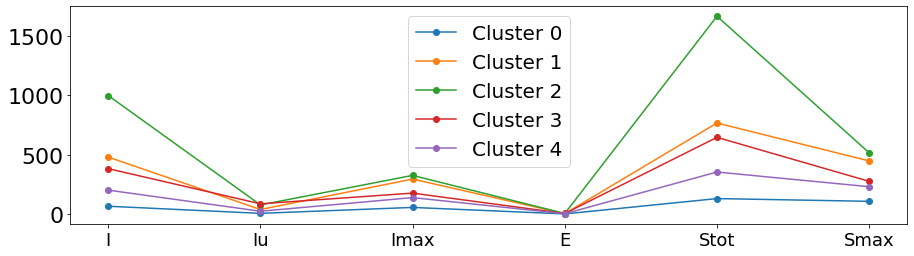

In [86]:
plt.figure(figsize=(15, 4))
for i in range(0, len(cs_centers[2])):
    plt.plot(cs_centers[2][i], marker='o', label='Cluster %s' % i)
plt.tick_params(axis='both', which='major', labelsize=22)
plt.xticks(range(0, len(cs_no_out.columns)), cs_no_out.columns, fontsize=18)
plt.legend(fontsize=20)
plt.show()

What emerges from both plots is that, again, *I* and *Stot* are the most relevant features for this clustering process (in particular, cluster 2 is that with the highest value of *Stot* attribute). This is a further confirmation of our decision of not to drop *Stot* when the high-correlation analysis suggested that it was above the maximum threshold.

This is a further confirmatiom of the conclusion stated before, that **clusters are actually grouped representing how much customers are buying, with respect to both quantity and expenditure.**

### K = 8
We now highlight again the cluster distribution for the case of *k* = 8.

In addiction to this distribution visualization, we are going to call back again each single categorical feature to make a complete interpretation of these eight clusters.

#### Clusters distributions: Pie Chart and Histogram

In [87]:
hist, bins = np.histogram(cs_labels[3], bins=range(0, len(set(cs_labels[3])) + 1))

<BarContainer object of 8 artists>

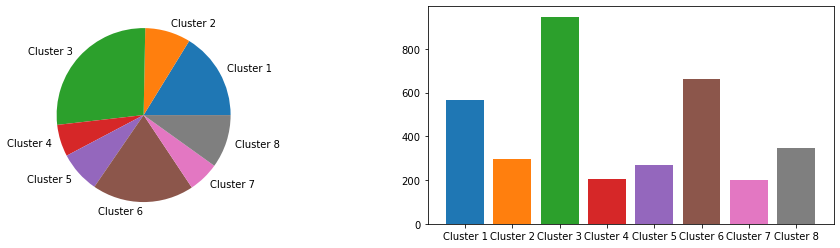

In [88]:
f, axs = plt.subplots(nrows=1, ncols=2, figsize=(16,4))
axs[0].pie(hist, labels=visual_labels[3])
axs[1].bar(list(range(1,Ks[3] + 1)), hist, color=visual_colors[3], tick_label=visual_labels[3])

#### Classification via categorical attributes
Now we bring up those categorical lables that were excluded from the cluster building process, in order to understand and interpret the  results of k-means algorithm.

##### Clusters by Country
Here we consider the *Country* attribute and we build plots in order to understand how clusters are distributed with respect to this lable. 

The first plot highlights the already known predominancy of United Kingdoms over all other countries, as discovered also during the Data Understanding and Preparation phases. As a matter of fact, here this predominancy is confirmed and clearly visible on the fact that most of the population (for all the eight clusters) is made by customers that made purchses from UK. 

Text(0.5, 1.0, 'UK and the other countries within the three clusters')

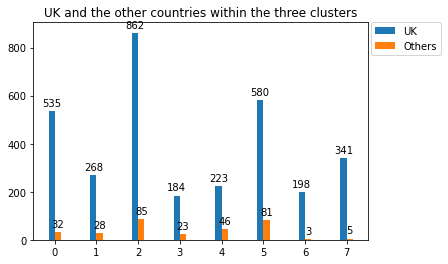

In [89]:
UK_bar = cs_clusters[cs_clusters.Country == 'United Kingdom'].groupby(['C8', 'Country']).size().unstack()
UK_bar['Others'] = pd.DataFrame(cs_clusters[cs_clusters.Country != 'United Kingdom'].groupby(['C8']).size())

other_countries = [[] for _ in range(Ks[3])]
other_values = [[] for _ in range(Ks[3])]
for cluster in range(Ks[3]):
    for country in cs_clusters[(cs_clusters.Country != 'United Kingdom') & (cs_clusters.C8 == cluster)].Country.unique():
        other_countries[cluster].append(country)
        other_values[cluster].append(cs_clusters[(cs_clusters.C8 == cluster) & (cs_clusters.Country == country)].Country.count())

x = np.arange(len(visual_labels[3]))
width = 0.15

f, axs = plt.subplots(nrows=1, ncols=1)
autolabel(axs.bar(x - width/2, UK_bar['United Kingdom'], width, label='UK'))
autolabel(axs.bar(x + width/2, UK_bar['Others'], width, label='Others'))
axs.legend(bbox_to_anchor=(1.01, 1), loc='upper left', borderaxespad=0.)
axs.set_title('UK and the other countries within the three clusters')

Then, the other eight plots focus on the other countries and their distribution within the eight clusters.

As we did before, we have chosen this split (UK vs other countries) in order to have plots that are as clear as possible and also to improve data visualization.

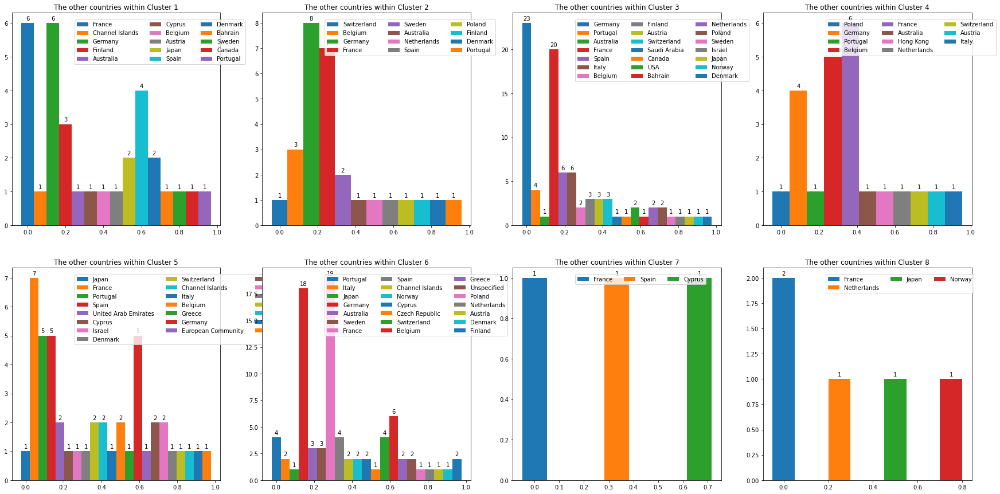

In [90]:
f, axs = plt.subplots(nrows=2, ncols=4, figsize=(30,15))

for i in [0,1]:
    for j in [0,1,2, 3]:
        for c in range(len(other_countries[i*4 + j])):
            point = (1/len(other_countries[i*4 + j]) * c)
            autolabel(axs[i][j].bar( point, other_values[i*4 + j][c], (min(1/len(other_countries[i*4 + j]), 0.1)), label=other_countries[i*4 + j][c]), i, j)
            axs[i][j].legend(bbox_to_anchor=(0.3, 0.97), loc='upper left', borderaxespad=0., ncol=3)
        axs[i][j].set_title('The other countries within Cluster ' + str(i*4 + j + 1))

As confirmation of the distribution analysis made by *Country* feature in the previous cases of three and five clusters, also here the majority of purchases is made by customers coming from the same countries: France, Germany, Belgium and Spain.

##### Clusters by Weekday
We now focus on the clusters distribution with respect to the *weekday* categorical feature, in order to understand if customers are grouped together on the basis on which day of the week they make purchases.

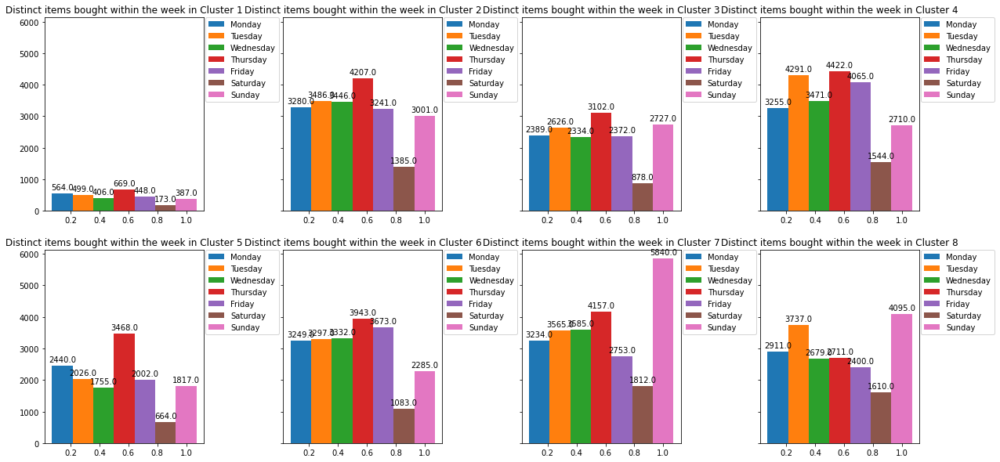

In [91]:
weekdays_bar = [[] for _ in range(Ks[3])]
for j in range(Ks[3]):
    for i in range(1,8):
        weekdays_bar[j].append(cs_clusters[cs_clusters.C8 == j][cs_cat.columns[i]].sum())

f, axs = plt.subplots(nrows=2, ncols=4, figsize=(20,10), sharey=True)
f.subplots_adjust(wspace=0.5)

for j in range(Ks[3]):
    for i in range(1,8):
        point = (1/len(weekdays_bar[j]) * i)
        autolabel(axs[int(j/4)][j%4].bar(point, weekdays_bar[j][i-1], 1/len(weekdays_bar[j]), label=cs_cat.columns[i]), int(j/4),j%4)
    axs[int(j/4)][j%4].legend(bbox_to_anchor=(1.01, 1), loc='upper left', borderaxespad=0.)
    axs[int(j/4)][j%4].set_title('Distinct items bought within the week in Cluster ' + str(j+1))

As confirmation of the distribution analysis made by *Weekday* feature in the previous cases of three and five clusters, also here it is evident that, among all the eight clusters, that the customers' favourite days for doing shopping are Sunday and Thursday.

##### Clusters by Month
Again, we perform the same analysis based on *month* categorical attribute, in order to understand if, in the clusters resulting from the algorithm, customers are grouped together on the basis of which month is the best for them to make purchases.

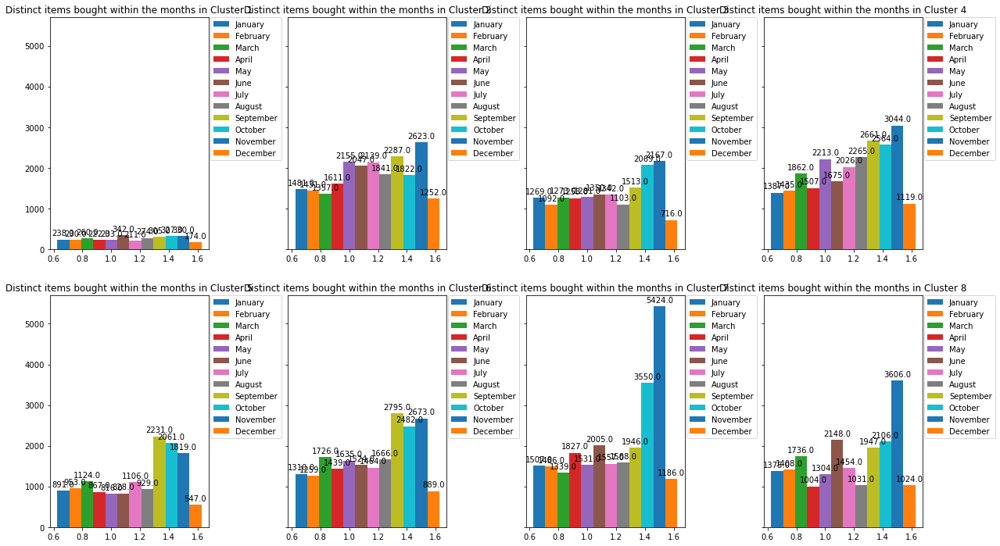

In [92]:
months_bar = [[] for _ in range(Ks[3])]
for j in range(Ks[3]):
    for i in range(8,20):
        months_bar[j].append(cs_clusters[cs_clusters.C8 == j][cs_cat.columns[i]].sum())
        
f, axs = plt.subplots(nrows=2, ncols=4, figsize=(20,12), sharey=True)
f.subplots_adjust(wspace=0.5)

for j in range(Ks[3]):
    for i in range(8,20):
        point = (1/len(months_bar[j]) * i)
        autolabel(axs[int(j/4)][j%4].bar(point, months_bar[j][i-8], 1/len(months_bar[j]), label=cs_cat.columns[i]), int(j/4),j%4)
    axs[int(j/4)][j%4].legend(bbox_to_anchor=(1.01, 1), loc='upper left', borderaxespad=0.)
    axs[int(j/4)][j%4].set_title('Distinct items bought within the months in Cluster ' + str(j+1))

As confirmation of the distribution analysis made by *Month* feature in the previous cases of three and five clusters, also here it is evident that clusters corresponding to fall months (September, October, but mostly November) are representing the favourite periods of the year fot the customers to make purchases.

#### Analysis of the centroids
We now exploit the bidimensional visualization to have a global view, and so we build scatter plots for all the pairs of correlations between features (to avoid repetition and redundant informations, we decided to print only what was above the main diagonal of the correlation matrix).  

Here you can clearly see the cluster separation and assignment in different colors, and also the centroids in red, so that is is immediate to understand and visualize where the center (i.e. the average value) is located for any cluster.

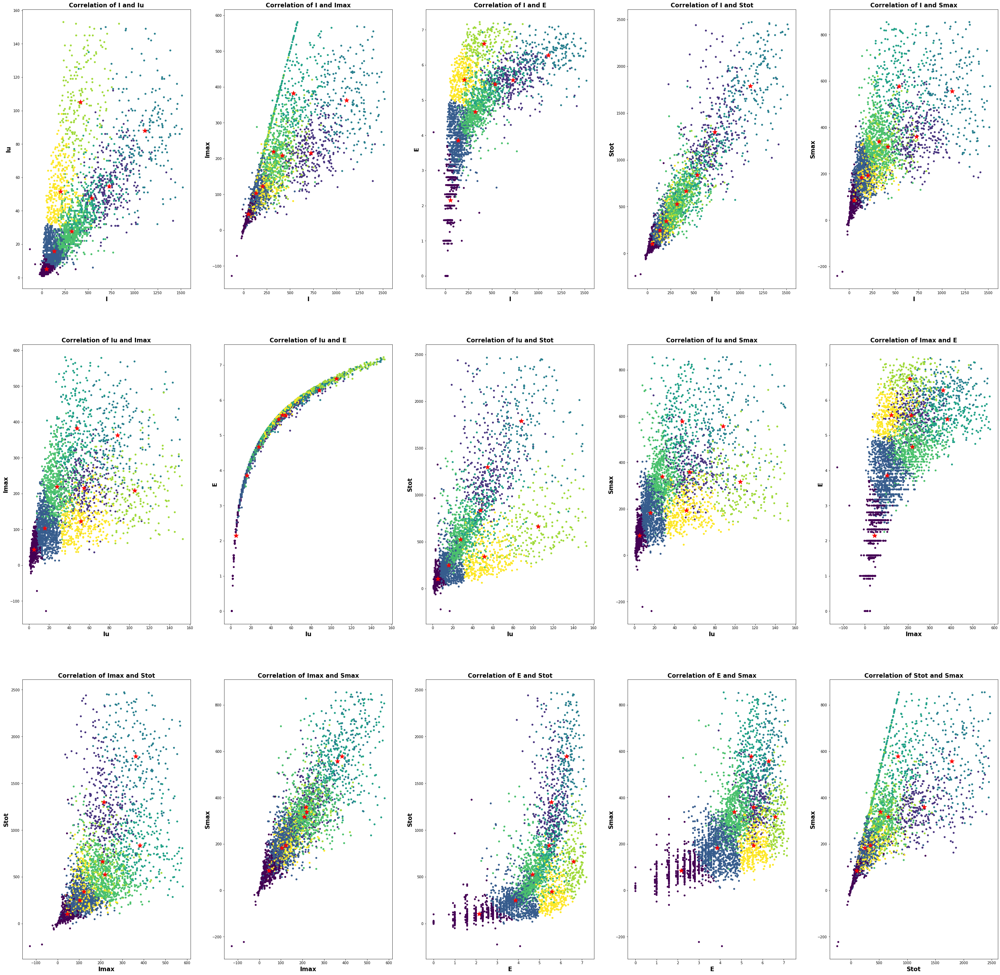

In [93]:
# scatter plots with centroids
f, axs = plt.subplots(nrows=3, ncols=5, figsize=(50,50))
index = 0
for i in range(0,len(cs_no_out.columns)):
    for j in range(i+1,len(cs_no_out.columns)):
        axs[int(index/5)][index%5].scatter(cs_no_out[cs_no_out.columns[i]], cs_no_out[cs_no_out.columns[j]], c=cs_labels[3], s=20)
        for h in range(len(cs_centers[3])):
            axs[int(index/5)][index%5].scatter(cs_centers[3][h][i], cs_centers[3][h][j], s=200, marker='*', c='r')
        axs[int(index/5)][index%5].set_title('Correlation of ' + cs_no_out.columns[i] + ' and ' + cs_no_out.columns[j], fontdict={'fontsize': 'xx-large', 'fontweight' : 'bold'})
        axs[int(index/5)][index%5].set_xlabel(cs_no_out.columns[i], fontdict={'fontsize': 'xx-large', 'fontweight' : 'bold'})
        axs[int(index/5)][index%5].set_ylabel(cs_no_out.columns[j], fontdict={'fontsize': 'xx-large', 'fontweight' : 'bold'})
        index = index + 1

It is not difficult to see that the the previous case of *k*=3 was better w.r.t visual representation, because clusters were better separated and there was not so much overlapping of points. 

Also from this evidence (but in addiction with the stronger confirmation of evaluation metrics results) we are able to say that 3 is the best value as number of cluster of k-means algorithm.

#### Radar plot
Again, with radar plots and parallel coordinates plot, for any centroid we report the value of the corresponding feature. In this way we are able to analyze what attribute is better representing clusters.

C:\Users\Diletta\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:13: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  del sys.path[0]


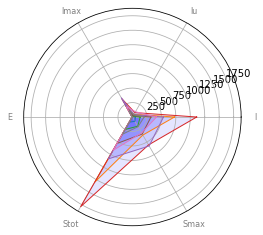

In [94]:
# centroids visualization via radar chart
from math import pi
 
# number of variable
N = len(cs_no_out.columns)
# What will be the angle of each axis in the plot? (we divide the plot / number of variable)
for i in range(0, len(cs_centers[3])):
    angles = [n / float(N) * 2 * pi for n in range(N)]
    values = cs_centers[3][i].tolist()
    values += values[:1]
    angles += angles[:1]
    # Initialise the spider plot
    ax = plt.subplot(polar=True)
# Draw one axe per variable + add labels labels yet
    plt.xticks(angles[:-1], cs_no_out.columns, color='grey', size=8) 
# Plot data
    ax.plot(angles, values, linewidth=1, linestyle='solid')
 # Fill area
    ax.fill(angles, values, 'b', alpha=0.1)

#### Parallel Coordinates

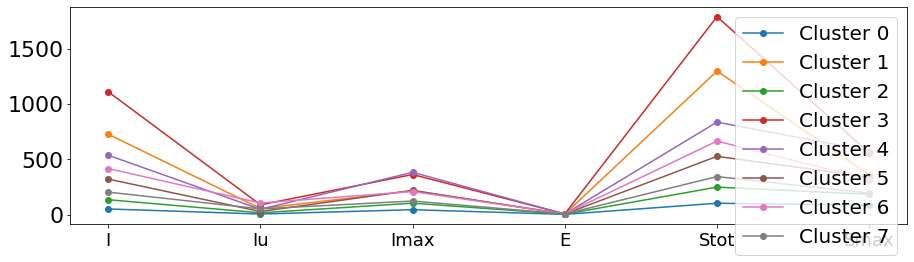

In [95]:
plt.figure(figsize=(15, 4))
for i in range(0, len(cs_centers[3])):
    plt.plot(cs_centers[3][i], marker='o', label='Cluster %s' % i)
plt.tick_params(axis='both', which='major', labelsize=22)
plt.xticks(range(0, len(cs_no_out.columns)), cs_no_out.columns, fontsize=18)
plt.legend(fontsize=20)
plt.show()

It is again confirmed from both plots that *I* and *Stot* are the most relevant features for this clustering process (in particular, cluster 6 is that with the highest value of *Stot* attribute).

This is again a further confirmatiom of the conclusion stated before, that **clusters are actually grouped representing how much customers are buying, with respect to both quantity and expenditure.**

## Evaluation of the clustering results
At this point, we are going to validate all the results obtained by k-means with 3, 5 and 8 clusters. In this way we will have a glibal picture of this clustering alorithm and of all the process, that will allow us to state and confirm numerically what is the best number of cluster for the optimal partition of this data. 

The (internal) evaluation metrics that we are going to compute are:
* **SSE** to measure cohesion
* **Davies Bouldin Score** to measure separation
* **Silhouette Score** to measure both

#### Measuring the cohesion : Sum Squared Error (SSE)


In [96]:
print('Cohesion: ')
for i in range(len(Ks)):
    print('For K = '+ str(Ks[i])+': '+ str(cs_inertia[i]))

Cohesion: 
For K = 2: 10408.826055849531
For K = 3: 7610.519879315318
For K = 5: 5341.966083572217
For K = 8: 3848.3778825132686


#### Measuring the separation: Davies Bouldin Score 

In [97]:
from sklearn.metrics import davies_bouldin_score
print('Separation (Davies Bouldin Score): ')
for i in range(len(Ks)):
    print('For K = '+ str(Ks[i])+': '+ str(davies_bouldin_score(cs_norm_minmax, cs_labels[i])))

Separation (Davies Bouldin Score): 
For K = 2: 0.9125742381462919
For K = 3: 1.0576102395179536
For K = 5: 1.0766842952239988
For K = 8: 1.0576966794039557


#### Measuring both cohesion and separation with the Silhouette Score  

In [98]:
print('Cohesion and Separation (Silhouette Score): ')
for i in range(len(Ks)):
    print('For K = '+ str(Ks[i])+': '+ str(silhouette_score(cs_norm_minmax, cs_labels[i])))

Cohesion and Separation (Silhouette Score): 
For K = 2: 0.4543736603697959
For K = 3: 0.3590662880819727
For K = 5: 0.3211971325134814
For K = 8: 0.29965723640716285


## K-means conclusion
What emergeds from the evaluation phase is that our hypotesis (coming from data visualization) that *k*=3 was the optimal choice is definitely confirmed by these numerical results.

### Pros
As sostained by literature, the k-means algorithm converges quickly.
Despite our data does not have globular shape, the results of the partitions was pretty good.


### Cons
The main disadvantage of k-means is that it requires to choose *a priori* the number of clusters to be identified; if the data is not naturally partitioned you get strange results. This human-driven definition for *k* values definitely required a lot of analysis and adjustments: in case of autonomous enstabilishment from the algorithm itself of the correct number of clusters (as we will see for DBSCAN), this entire process would not have been necessary. 

In terms of the quality of the solutions, the algorithm does not guarantee the achievement of the global optimum: the quality of the final solution largely depends on the initial set of groups and can, in practice, obtain a solution much worse than the overall optimum. Since the algorithm is usually extremely fast, it is possible to apply it several times and choose the most satisfactory solution among those produced.

# Clustering analysis by density clustering

The main aim of density-based algorithms is to find **dense regions of space**, i.e. areas in which there is an agglomeration of points.
The notion of density, as well as the way in which we can quantify this "agglomerations", are determined by the choice of parameters.

Density-based clustering methods differ from k-means in the fact that they **do not specify the number of clusters beforehand**. Moreover, unlike other clustering methods, they **incorporate a notion of outliers and are able to “filter” these out**. 

**DBSCAN algorithm**

We perform the density-based clustering using DBSCAN (*Density-Based Spatial Clustering of Applications with Noise*) algorithm.

It has only two parameters...
* **eps**: The maximum distance between two samples for them to be considered as in the same neighborhood.
* **min_samples**: the minimum number of points needed to create a cluster.

... and one output:
* cluster **labels** for each point in the dataset. Noisy samples are given the label -1.

In [99]:
from sklearn.cluster import DBSCAN

In [100]:
# INPUT
dbscan = DBSCAN(eps=0.55, min_samples=15) # algorithmic parameters
dbscan.fit(cs_norm_minmax)

DBSCAN(algorithm='auto', eps=0.55, leaf_size=30, metric='euclidean',
       metric_params=None, min_samples=15, n_jobs=None, p=None)

In [101]:
# OUTPUT
d_labels = []
d_labels.append(dbscan.labels_)
d_labels 

[array([-1, -1,  0, ...,  0,  0, -1], dtype=int64)]

## Parameters tuning 
In order to understand which is the optimal assignment for both the parameters, we had to do a lot of executions and trials, exploring different combinations of values (summarized in a table below).

We tried different values for the *min_sample* parameter (also called *k* in this context) in order to know how many neightbors we had to consider in a region with radius *eps* (second parameter) so that we can appropriately call that region a "cluster".

This process is clearly visible in the plots below.

Then, using the **knee method** we selected the candidates as best values of *eps*, for all the *min_sample* tried.

### Knee method 

**Few neighbors**

Evaluation for: *20 < min_samples < 5*

In [102]:
from scipy.spatial.distance import pdist, squareform
dist = pdist(cs_norm_minmax, 'euclidean') #pair wise distance
print (dist)
dist = squareform(dist) #distance matrix given the vector dist

[1.98824102 3.22621471 2.23505658 ... 2.35204454 3.8730032  6.18746357]


Thanks to visualization tool we can estimate where the value of *eps* parameter gets lower and lower, since it becomes stable. 

In particular, we create several plots experimenting different values for *k* to have a stronger confirm of what are the best associations for different values of *k* and *eps* parameters.

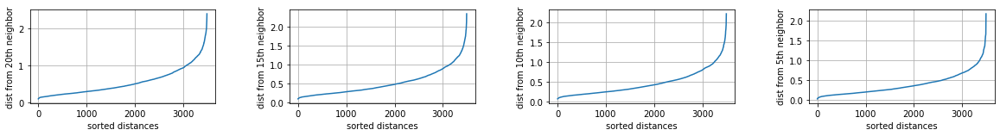

In [103]:
# Set up a grid of plots:
fig = plt.figure(figsize=(20,2))
fig_dims = (1, 4)
fig.subplots_adjust(hspace=0.4, wspace=0.4)

k = 20
    
for i in range(0,1):
    for j in range(0,4):
        plt.subplot2grid(fig_dims, (i,j))
        kth_distances = list()
        for d in dist:
            index_kth_distance = np.argsort(d)[k]
            kth_distances.append(d[index_kth_distance])
        plt.plot(range(0, len(kth_distances)), sorted(kth_distances))
        plt.ylabel('dist from %sth neighbor' % k)
        plt.xlabel('sorted distances')
        plt.tick_params(axis='both', which='major')
        plt.grid(True)
        
        k-=5

From these plots it seems clear that the **candidates values for *eps* parameter are between 0.5 and 1**.

To confirm which is the best one, for each respective *k* quantiy of neightbors, we did a lot of executions, summarized in the table below. 

**Many neightbors**

Evaluation for: *min_samples > 20*

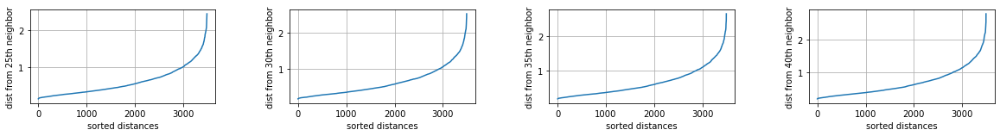

In [104]:
# Set up a grid of plots:
fig = plt.figure(figsize=(20,2))
fig_dims = (1, 4)
fig.subplots_adjust(hspace=0.4, wspace=0.4)

k = 25
    
for i in range(0,1):
    for j in range(0,4):
        plt.subplot2grid(fig_dims, (i,j))
        kth_distances = list()
        for d in dist:
            index_kth_distance = np.argsort(d)[k]
            kth_distances.append(d[index_kth_distance])
        plt.plot(range(0, len(kth_distances)), sorted(kth_distances))
        plt.ylabel('dist from %sth neighbor' % k)
        plt.xlabel('sorted distances')
        plt.tick_params(axis='both', which='major')
        plt.grid(True)
        
        k+=5

Also in the case of many neightbors considered, the *eps* value starts decreasing between 0.5 and 1.

### Executions report

This table summarizes all the trials we did and the respective considerations about the results we obtained.

In [105]:
summary = pd.read_csv('param_tuning.csv', sep=';', index_col=0)
summary

,Min neightbors (k),Eps (between 0.5 and 1.5),Num of clusters,Noisy points,Noise/Clusters ratio,Considerations
Run,,,,,,
1,5,0.50,13,607,46,Too many clusters
2,5,0.75,6,182,30,Overfit
3,5,0.80,3,138,46,Overfit
4,5,0.85,2,101,50,Overfit
5,5,1.00,2,44,22,Overfit
6,10,0.50,3,850,283,"Some noise in dense region, but nice visualiza..."
7,10,0.80,2,253,126,Overfit
8,10,1.00,8,3360,420,"Too many clusters, underfit"
9,10,1.30,2,11,5,Overfit


The executions commented with *overfit* are those with too few noisy point detected with respect to the number of clusters found (viceversa for *underfit* comment).

### Best configuration of parameters
What emerges from the previous analysis on parameters tuning (further supported by some tests on data visualization that we did in this preliminary phase) is that the best combination of parameters to use with this dataset to perform the DBSCAN algorithm are:

- **case1**: *min_sample* = 5, *eps* = 0.86
- **case2**: *min_sample* = 20, *eps* = 0.75 (and some equivalent configurations with the same ratio between number of clusters and noise discovered, like this one:  min_sample = 25, eps = 0.7)  


Both the configurations returned a number of clusters equal to 2.

As a matter of fact, this combo **returns the best balance between noise points and number of clusters detected**.

### Two possible noise interpretations
These two cases are different in the way in which noise can be interpreted. Depending on these interpretations, both correct, we can recognize two possible outcomes:

* *Interpretation of case1*: even if there are both more-dense and less-dense regions, since DBSCAN in not able to recognize them as two separate clusters (as explained before), the algorithm creates a unique cluster which includes both, labeled with 0. The remaining points (assigned to -1 label) represents what we properly call *noise*, i.e. data points that are really far from the dense area.

* *Interpretation of case2*: since DBSCAN is not able to recognize clusters with diffrent densities, it assigns the most dense region to label 0 and the remaining region (less dense) to the label -1 : in this case, the meaning of the label -1 is *not* representing the usual definition of *noise*, but just the **inability of DBSCAN to recognize two different clusters with different densities**.

We will support these hypoteses using data visualization tool (see scatter plots below).

### Running DBSCAN with different parameters

In [106]:
eps_values = [0.86, 0.75]
min_samples_values = [5, 20]
dbscan = [] 

for i in range(len(eps_values)): 
    d = DBSCAN(eps=eps_values[i], min_samples=min_samples_values[i]) # algorithmic parameters
    dbscan.append(d)
    dbscan[i].fit(cs_norm_minmax)

In [107]:
dbscan

[DBSCAN(algorithm='auto', eps=0.86, leaf_size=30, metric='euclidean',
        metric_params=None, min_samples=5, n_jobs=None, p=None),
 DBSCAN(algorithm='auto', eps=0.75, leaf_size=30, metric='euclidean',
        metric_params=None, min_samples=20, n_jobs=None, p=None)]

### Statistics
Since density-based clustering algorithms do not have the possibility of deciding *a priori* the number of clusters, we must print the labels' population in order to see **how many clusters** the algorithm has found and also the **size** of each of them (i.e. how many points each cluster contains).

As further informations, we also print how much noise the algorithm has detected for each run.

In [108]:
dbscan_complete = pd.DataFrame()

number_of_classes = []
n_noise = []
dbs_run=[]

for i in range(len(eps_values)): 
    number_of_classes.append(np.unique(dbscan[i].labels_).shape[0])
    n_noise.append(list(dbscan[i].labels_).count(-1))
    dbs_run.append(i+1)

In [109]:
dbscan_complete['DBSCAN case'] = dbs_run
dbscan_complete['K'] = min_samples_values
dbscan_complete['Eps'] = eps_values
dbscan_complete['Number of clusters'] = number_of_classes

In [110]:
dbscan_population = []
for i in range(len(eps_values)): 
    dbscan_population.append(list(dbscan[i].labels_).count(0))

dbscan_complete['Noise label'] = -1
dbscan_complete['Noise population'] = n_noise
dbscan_complete['Cluster label'] = 0
dbscan_complete['Cluster population'] = dbscan_population

dbscan_complete

,DBSCAN case,K,Eps,Number of clusters,Noise label,Noise population,Cluster label,Cluster population
0,1,5,0.86,2,-1,99,0,3395
1,2,20,0.75,2,-1,483,0,3011


### Visualization of density-based clustering in two dimensions

#### Scatter plots

Now we plot all the features correlations in order to fully visualize all the dense regions detected and the noise.

#### Case1: *k* = 5 and *eps* = 0.86

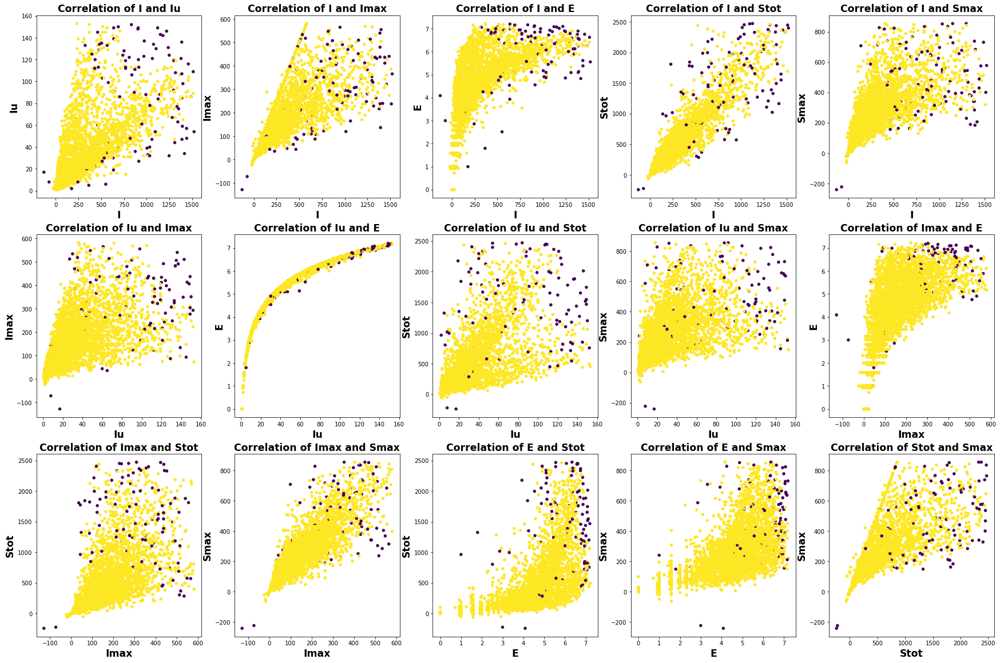

In [135]:
f, axs = plt.subplots(nrows=3, ncols=5, figsize=(30,20))
index = 0
for i in range(0,len(cs_no_out.columns)):
    for j in range(i+1,len(cs_no_out.columns)):
        axs[int(index/5)][index%5].scatter(cs_no_out[cs_no_out.columns[i]], cs_no_out[cs_no_out.columns[j]], c=dbscan[0].labels_, s=20)
        axs[int(index/5)][index%5].set_title('Correlation of ' + cs_no_out.columns[i] + ' and ' + cs_no_out.columns[j], fontdict={'fontsize': 'xx-large', 'fontweight' : 'bold'})
        axs[int(index/5)][index%5].set_xlabel(cs_no_out.columns[i], fontdict={'fontsize': 'xx-large', 'fontweight' : 'bold'})
        axs[int(index/5)][index%5].set_ylabel(cs_no_out.columns[j], fontdict={'fontsize': 'xx-large', 'fontweight' : 'bold'})
        index = index + 1

It is easy to see that DBSCAN is not able to distinguish more-dense and less-dense regions as different clusters (as opposed to k-means that did it properly): so it groups them into a unique cluster (the yellow one). In this situation, data points labeled with -1 are *literally* noise points. 

#### Case2: *k* = 20 and *eps* = 0.75

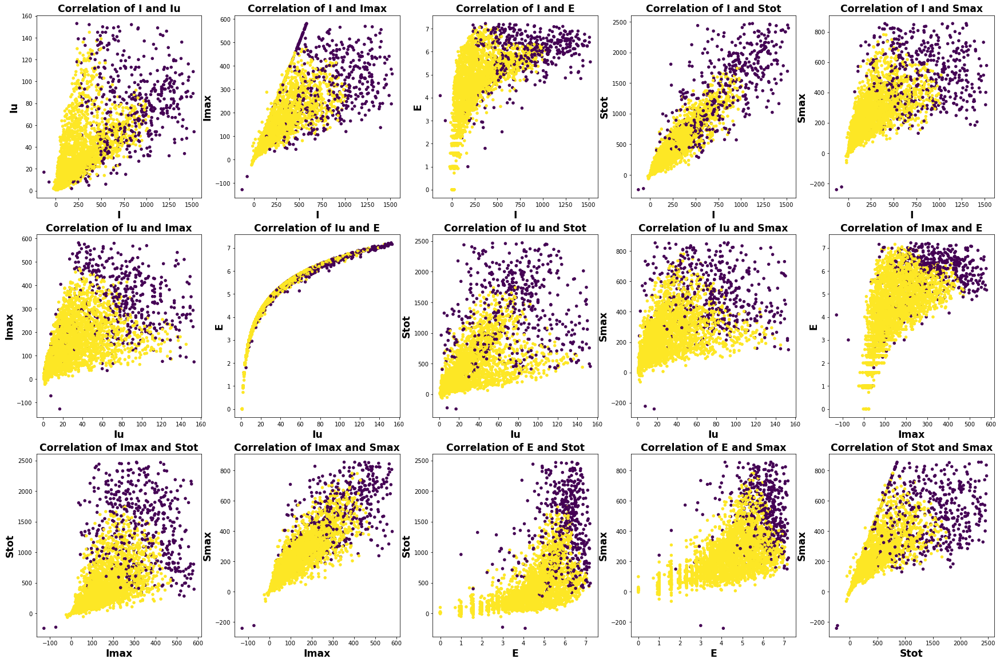

In [136]:
f, axs = plt.subplots(nrows=3, ncols=5, figsize=(30,20))
index = 0
for i in range(0,len(cs_no_out.columns)):
    for j in range(i+1,len(cs_no_out.columns)):
        axs[int(index/5)][index%5].scatter(cs_no_out[cs_no_out.columns[i]], cs_no_out[cs_no_out.columns[j]], c=dbscan[1].labels_, s=20)
        axs[int(index/5)][index%5].set_title('Correlation of ' + cs_no_out.columns[i] + ' and ' + cs_no_out.columns[j], fontdict={'fontsize': 'xx-large', 'fontweight' : 'bold'})
        axs[int(index/5)][index%5].set_xlabel(cs_no_out.columns[i], fontdict={'fontsize': 'xx-large', 'fontweight' : 'bold'})
        axs[int(index/5)][index%5].set_ylabel(cs_no_out.columns[j], fontdict={'fontsize': 'xx-large', 'fontweight' : 'bold'})
        index = index + 1

Here the inability of DBSCAN to clusterize together the two regions with different densities is interpreted in another way: since it cannot assign a separate cluster to the less-dense region, it automatically assigns to it the lable -1. But, coherently with this interpretation, -1 points are not properly *noise*, but the representation of the algorithm's limitation.

### Post-processing analysis
#### Comments on data visualization results



* **Robustness to noise**. It is clearly evident one of the major advantage of the density-based clustering: it is able to detect whatever it recognizes as noise and to label it as -1.
* **Ability to capture clusters with different shapes**. The yellow cluster is clearly a non-globular cluster but DBSCAN can easily detect it.
* **Unable to detect variable densities**. This is a well known limitation of DBSCAN algorithm, and here we have the opportunity to clearly see it: in the second interpretation we proposed, the 'agglomerate' in yellow is the most dense part and so it is correctly recognized as a cluster, but the purple one is classified as noise just because it is less dense that the other. To make a comparison, k-means algorithm instead classified that region as a separate cluster.

### Evaluation with internal metrics
Now we reinfoce this observations based on data viasualization with numerical informations. We start computing internal indexes and then we proceed also in computing external ones.

#### Silhouette and separation score

The silouhette score describes not only the cohesion but also separation between clusters (it is able to capture if clusters are well separated or not).

A value of silhouette equal to 1 means that there is a good cohesion and separation between clusters.

In [877]:
from sklearn import metrics

sil = []
sep = []

for i in range(len(eps_values)): 
    # print statistics
    sil.append(silhouette_score(cs_norm_minmax, dbscan[i].labels_))
    sep.append(metrics.davies_bouldin_score(cs_norm_minmax, dbscan[i].labels_))

dbscan_complete['Silhouette'] = sil
dbscan_complete['Separation'] = sep
dbscan_complete

,DBSCAN case,K,Eps,Number of clusters,Noise label,Noise population,Cluster label,Cluster population,Silhouette,Separation
0,1,5,0.86,2,-1,99,0,3395,0.400215,1.315808
1,2,20,0.75,2,-1,483,0,3011,0.439875,1.042532


The result shows that the two obtained clusters are well-separated, expecially in case1, but not so cohesive.

### Evaluation with external metrics
We now introduce again categorical features to interprete clusters' semantic and to understand how they are distributed.

**External indexes**

The metrics that we are going to use are:
- **Similarity** between original features and labels found by the algorithm.
- **Homogeneity** that measures if clusters are homogeneous wrt class labels. A value equal to 1 means that cluster are of the same type of the original label (i.e. categorical feature).
- **Completeness** measures how much original labels are concentrated in specific clusters.
- **Mutual Information** is a function that measures the agreement of the two assignments (i.e. original classes and labels assigned by the algorithm), ignoring permutations.

#### External metrics evaluation for DBSCAN case1

In [878]:
from sklearn import metrics

dbs1=pd.DataFrame()
dbs2=pd.DataFrame()

temp=[]
sim=[[],[]]
hom=[[],[]]
compl=[[],[]]
mutinfo=[[],[]]

for column in cs_cat:
    temp.append(column)
    for i in range(2):
        sim[i].append(metrics.adjusted_rand_score(cs_cat[column], dbscan[i].labels_))
        hom[i].append(metrics.homogeneity_score(cs_cat[column], dbscan[i].labels_))
        compl[i].append(metrics.completeness_score(cs_cat[column], dbscan[i].labels_))
        mutinfo[i].append(metrics.normalized_mutual_info_score(cs_cat[column], dbscan[i].labels_, average_method='arithmetic'))
    
dbs1['Feature'] = temp
dbs1['Similarity'] = sim[0]
dbs1['Homogeneity'] = hom[0]
dbs1['Completeness'] = compl[0]
dbs1['Mutual Information'] = mutinfo[0]
        
print('\n\nExternal metrics for DBSCAN case 1')
dbs1



External metrics for DBSCAN case 1


,Feature,Similarity,Homogeneity,Completeness,Mutual Information
0,Country,-0.002803,0.005878,0.024088,0.009451
1,Monday,0.029204,0.008740,0.129438,0.016375
2,Tuesday,0.030480,0.009063,0.140630,0.017029
3,Wednesday,0.037104,0.011231,0.162703,0.021012
4,Thursday,0.018542,0.007833,0.135940,0.014812
5,Friday,0.039316,0.009064,0.135384,0.016990
6,Saturday,0.047936,0.013363,0.097756,0.023512
7,Sunday,0.037729,0.011534,0.161474,0.021531
8,January,0.040532,0.008849,0.075670,0.015845
9,February,0.030476,0.008567,0.069010,0.015241


#### External metrics evaluation for DBSCAN case2

In [770]:
dbs2['Feature'] = temp
dbs2['Similarity'] = sim[1]
dbs2['Homogeneity'] = hom[1]
dbs2['Completeness'] = compl[1]
dbs2['Mutual Information'] = mutinfo[1]

print('\n\nExternal metrics for DBSCAN case 2')
dbs2



External metrics for DBSCAN case 2


,Feature,Similarity,Homogeneity,Completeness,Mutual Information
0,Country,0.009518,0.008944,0.011759,0.010160
1,Monday,0.098128,0.017642,0.083832,0.029150
2,Tuesday,0.108934,0.019846,0.098805,0.033053
3,Wednesday,0.124055,0.020062,0.093252,0.033020
4,Thursday,0.085339,0.018508,0.103061,0.031381
5,Friday,0.120852,0.020647,0.098956,0.034166
6,Saturday,0.111120,0.024183,0.056763,0.033916
7,Sunday,0.110269,0.021596,0.097006,0.035328
8,January,0.110016,0.017489,0.047985,0.025635
9,February,0.113843,0.023155,0.059848,0.033391


What we get from this analysis is that

### Cross Tables
In order to understand even better how categorical features are distributed with respect to DBSCAN executions results, we now build some cross tables and barplots.

We report a complete analysis for each categorical attribute.

### Country attribute

In [879]:
cross_Country=[]
# Create cross tables
for i in range(len(eps_values)): 
    cross_Country.append(pd.crosstab(dbscan[i].labels_, cs_cat.Country))

In [880]:
# useful changes for visualization
for i in range(len(eps_values)):
    cs_clusters['DBS' + str(i+1)] = dbscan[i].labels_

#### Clusters and noise interpretation by country for DBSCAN case1


We now plot customers informations related to DBSCAN case 1:
 DBSCAN case              1.000000
K                        5.000000
Eps                      0.860000
Number of clusters       2.000000
Noise label             -1.000000
Noise population        99.000000
Cluster label            0.000000
Cluster population    3395.000000
Silhouette               0.400215
Separation               1.315808
Name: 0, dtype: float64 




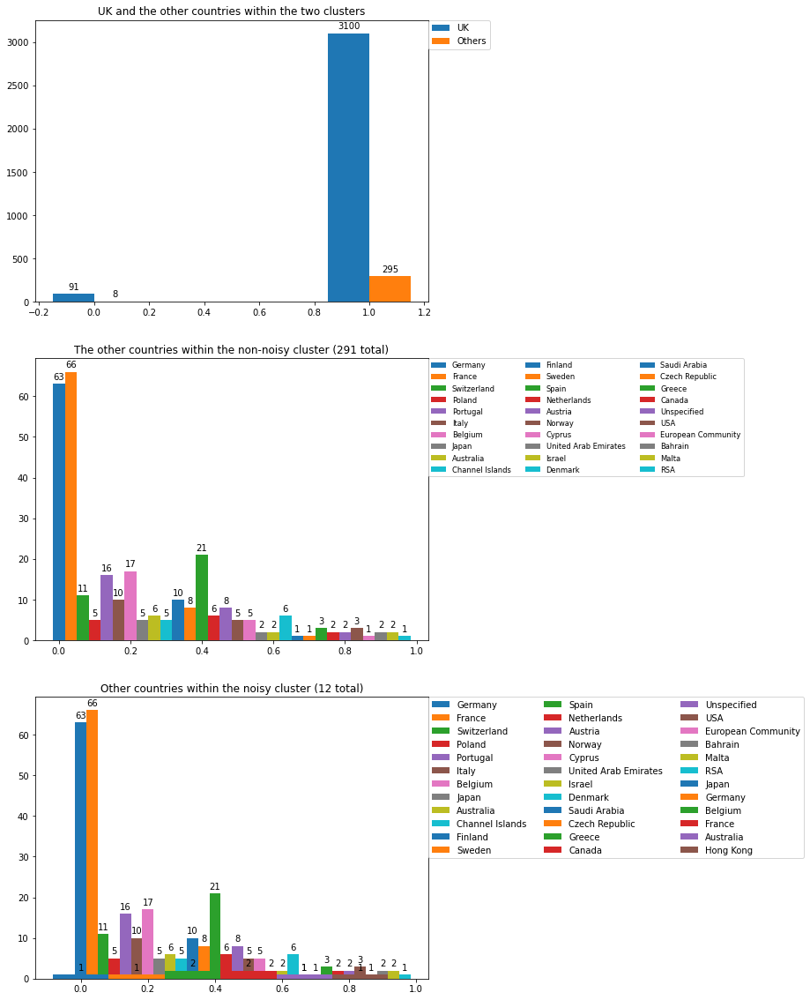

In [919]:
d_visual_labels=['Cluster 1', 'Cluster 2']

UK_bar = cs_clusters[cs_clusters.Country == 'United Kingdom'].groupby(['DBS1', 'Country']).size().unstack()
UK_bar['Others'] = pd.DataFrame(cs_clusters[cs_clusters.Country != 'United Kingdom'].groupby(['DBS1']).size())

other_countries = [[] for _ in range(2)]
other_values = [[] for _ in range(2)]
lab =[-1, 0]
for cluster in lab:
    for country in cs_clusters[(cs_clusters.Country != 'United Kingdom') & (cs_clusters.DBS1 == cluster)].Country.unique():
        other_countries[cluster].append(country)
        other_values[cluster].append(cs_clusters[(cs_clusters.DBS1 == cluster) & (cs_clusters.Country == country)].Country.count())
print('\nWe now plot customers informations related to DBSCAN case 1:\n',dbscan_complete.loc[0],'\n\n')
 
x = np.arange(len(d_visual_labels))
width = 0.15

f, axs = plt.subplots(nrows=3, figsize=(8,20))
autolabel(axs[0].bar(x - width/2, UK_bar['United Kingdom'], width, label='UK'), 0)
autolabel(axs[0].bar(x + width/2, UK_bar['Others'], width, label='Others'), 0)
axs[0].legend(bbox_to_anchor=(1, 1), loc='upper left', borderaxespad=0.)
axs[0].set_title('UK and the other countries within the two clusters')

for j in range(len(other_countries[0])):
    point = (1/len(other_countries[0]) * j)
    autolabel(axs[1].bar(point, other_values[0][j], (1/len(other_countries[0])), label=other_countries[0][j]), 1)
axs[1].legend(bbox_to_anchor=(1, 1), loc='upper left', borderaxespad=0., ncol=3, fontsize='small')
axs[1].set_title('The other countries within the non-noisy cluster (291 total)')

for i in [0,1]:
    for j in range(len(other_countries[i])):
        point = (1/len(other_countries[i]) * j)
        autolabel(axs[2].bar( point, other_values[i][j], (1/len(other_countries[i])), label=other_countries[i][j]), 2)
        axs[2].legend(bbox_to_anchor=(1, 1), loc='upper left', borderaxespad=0., ncol=3)
        axs[2].set_title('Other countries within the noisy cluster (12 total)')

#### Clusters and noise interpretation by country for DBSCAN case2


We now plot customers informations related to DBSCAN case 2:
 DBSCAN case              2.000000
K                       20.000000
Eps                      0.750000
Number of clusters       2.000000
Noise label             -1.000000
Noise population       483.000000
Cluster label            0.000000
Cluster population    3011.000000
Silhouette               0.439875
Separation               1.042532
Name: 1, dtype: float64 




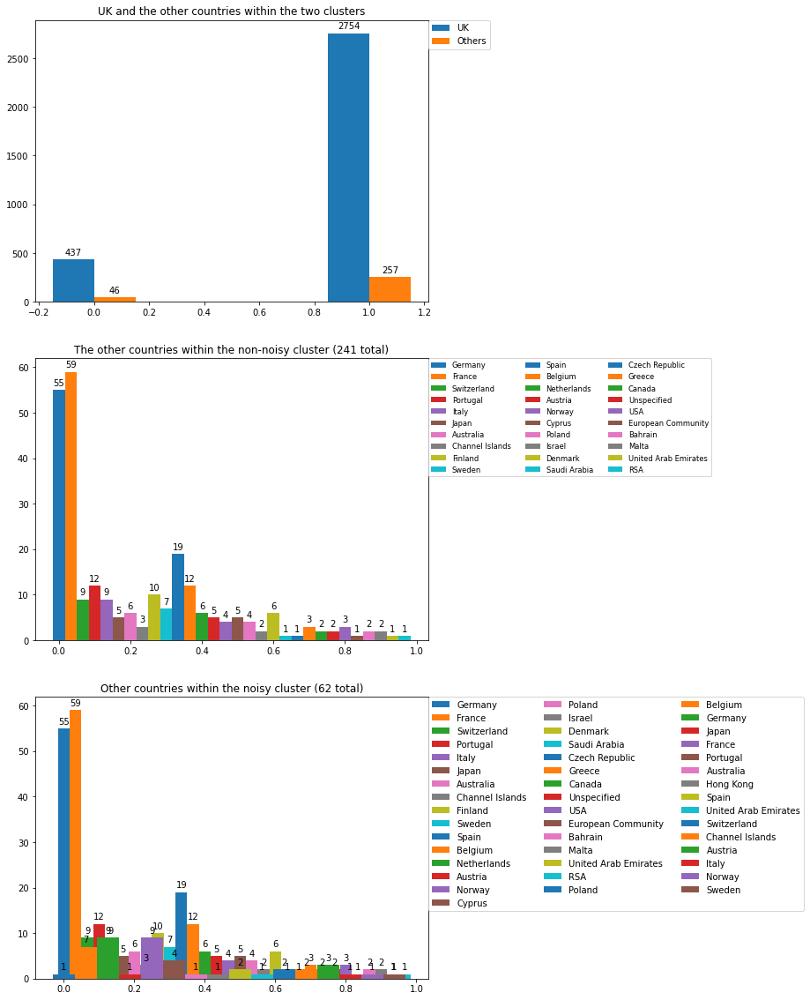

In [921]:
d_visual_labels=['Cluster 1', 'Cluster 2']

UK_bar = cs_clusters[cs_clusters.Country == 'United Kingdom'].groupby(['DBS2', 'Country']).size().unstack()
UK_bar['Others'] = pd.DataFrame(cs_clusters[cs_clusters.Country != 'United Kingdom'].groupby(['DBS2']).size())

other_countries = [[] for _ in range(2)]
other_values = [[] for _ in range(2)]
lab =[-1, 0]
for cluster in lab:
    for country in cs_clusters[(cs_clusters.Country != 'United Kingdom') & (cs_clusters.DBS2 == cluster)].Country.unique():
        other_countries[cluster].append(country)
        other_values[cluster].append(cs_clusters[(cs_clusters.DBS2 == cluster) & (cs_clusters.Country == country)].Country.count())

print('\nWe now plot customers informations related to DBSCAN case 2:\n',dbscan_complete.loc[1],'\n\n')
 
x = np.arange(len(d_visual_labels))
width = 0.15

f, axs = plt.subplots(nrows=3, figsize=(8,20))
autolabel(axs[0].bar(x - width/2, UK_bar['United Kingdom'], width, label='UK'), 0)
autolabel(axs[0].bar(x + width/2, UK_bar['Others'], width, label='Others'), 0)
axs[0].legend(bbox_to_anchor=(1, 1), loc='upper left', borderaxespad=0.)
axs[0].set_title('UK and the other countries within the two clusters')

for j in range(len(other_countries[0])):
    point = (1/len(other_countries[0]) * j)
    autolabel(axs[1].bar(point, other_values[0][j], (1/len(other_countries[0])), label=other_countries[0][j]), 1)
axs[1].legend(bbox_to_anchor=(1, 1), loc='upper left', borderaxespad=0., ncol=3, fontsize='small')
axs[1].set_title('The other countries within the non-noisy cluster (241 total)')

for i in [0,1]:
    for j in range(len(other_countries[i])):
        point = (1/len(other_countries[i]) * j)
        autolabel(axs[2].bar( point, other_values[i][j], (1/len(other_countries[i])), label=other_countries[i][j]), 2)
        axs[2].legend(bbox_to_anchor=(1, 1), loc='upper left', borderaxespad=0., ncol=3)
        axs[2].set_title('Other countries within the noisy cluster (62 total)')

Comments...

### Weekday attribute
#### Population

In [832]:
# Create cross table
cross_week=[]
for i in range(len(eps_values)): 
    cross_week.append(pd.crosstab(dbscan[i].labels_, cs_cat.Weekday))

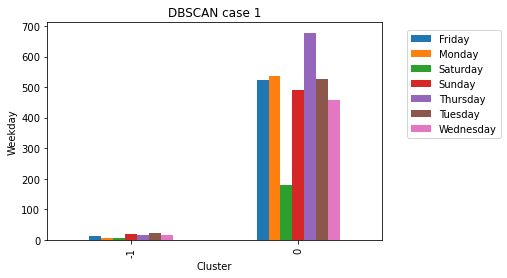

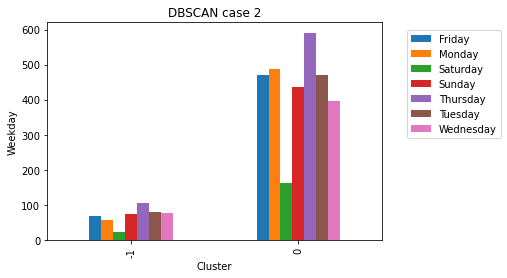

In [836]:
for i in range(len(eps_values)): 
    j=i+1
    cross_week[i].plot(kind='bar', stacked=False, title='DBSCAN case %i' % j)
    plt.xlabel('Cluster')
    plt.ylabel('Weekday')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.8)

This analysis confirms the results we got of k-means post-processing phase: the favourite day for customers to go shopping is Thursday. 

However, DBSCAN clusters result gives us a further information: the algorithm found new days in which the purchasing behavior of customers is high: Monday and Friday. 

#### Cluster and noise interpretations by weekday

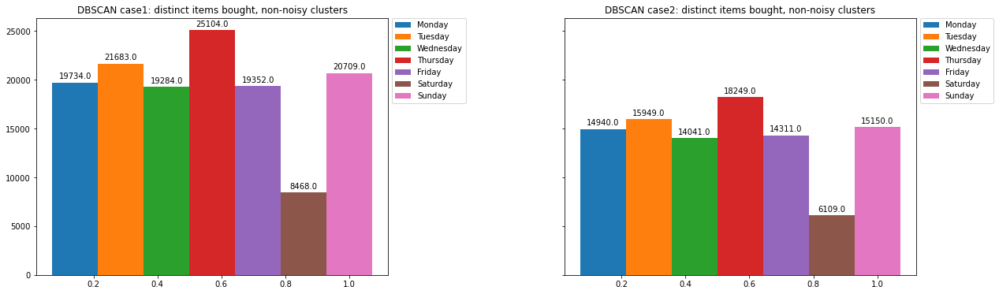

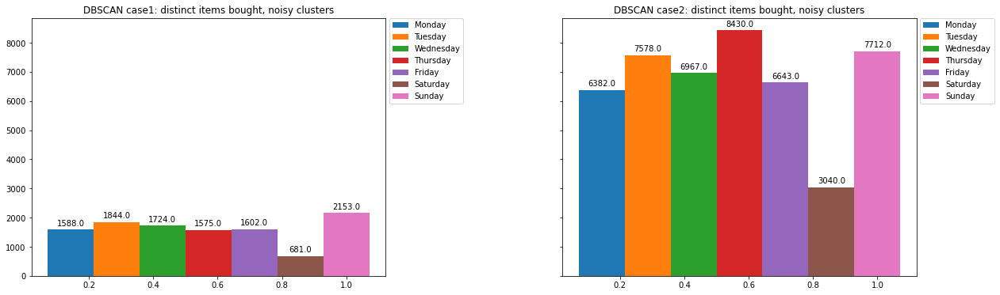

In [925]:
weekdays_bar = [[] for _ in range(4)]

for i in range(1,8):
    weekdays_bar[0].append(cs_clusters[cs_clusters.DBS1 == 0][cs_cat.columns[i]].sum())
    weekdays_bar[1].append(cs_clusters[cs_clusters.DBS2 == 0][cs_cat.columns[i]].sum())
    weekdays_bar[2].append(cs_clusters[cs_clusters.DBS1 == -1][cs_cat.columns[i]].sum())
    weekdays_bar[3].append(cs_clusters[cs_clusters.DBS2 == -1][cs_cat.columns[i]].sum())

f, axs = plt.subplots(nrows=1, ncols=2, figsize=(20,6), sharey=True)
f.subplots_adjust(wspace=0.5)

for j in range(2):
    for i in range(1,8):
        point = (1/len(weekdays_bar[j]) * i)
        autolabel(axs[j].bar(point, weekdays_bar[j][i-1], 1/len(weekdays_bar[j]), label=cs_cat.columns[i]), j)
    axs[j].legend(bbox_to_anchor=(1.01, 1), loc='upper left', borderaxespad=0.)
    axs[j].set_title('DBSCAN case' + str(j+1) + ': distinct items bought, non-noisy clusters')     

f, axs = plt.subplots(nrows=1, ncols=2, figsize=(20,6), sharey=True)
f.subplots_adjust(wspace=0.5)

for j in range(2):
    for i in range(1,8):
        point = (1/len(weekdays_bar[j+2]) * i)
        autolabel(axs[j].bar(point, weekdays_bar[j+2][i-1], 1/len(weekdays_bar[j+2]), label=cs_cat.columns[i]), j)
    axs[j].legend(bbox_to_anchor=(1.01, 1), loc='upper left', borderaxespad=0.)
    axs[j].set_title('DBSCAN case' + str(j+1) + ': distinct items bought, noisy clusters') 

### Month attribute
#### Population

In [833]:
# Create cross table
cross_month=[]
for i in range(len(eps_values)): 
    cross_month.append(pd.crosstab(dbscan[i].labels_, cs_cat.Month))

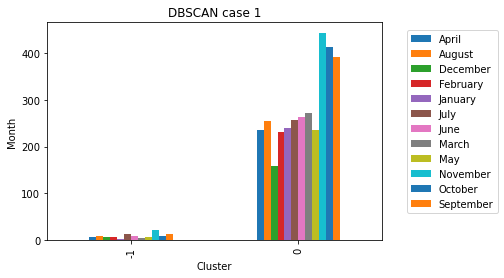

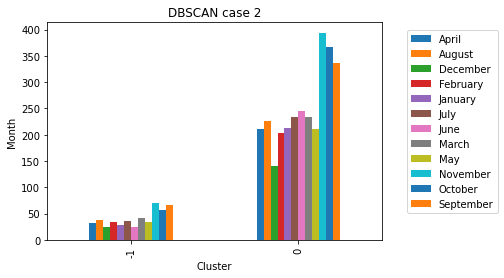

In [840]:
for i in range(len(eps_values)): 
    j=i+1
    cross_month[i].plot(kind='bar', stacked=False, title='DBSCAN case %i' % j)
    plt.xlabel('Cluster')
    plt.ylabel('Month')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.8)

Again the results of k-means algorithm are totally confirmed: DBSCAN too has discovered that the best month to make purchases are the fall-month (September, October, and mostly November).

#### Cluster and noise interpretations by month

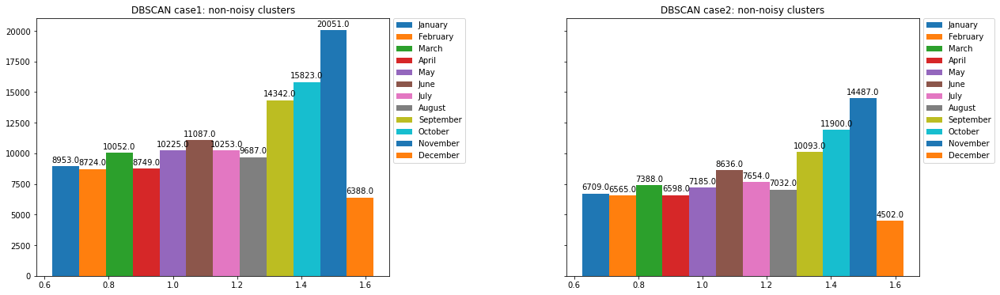

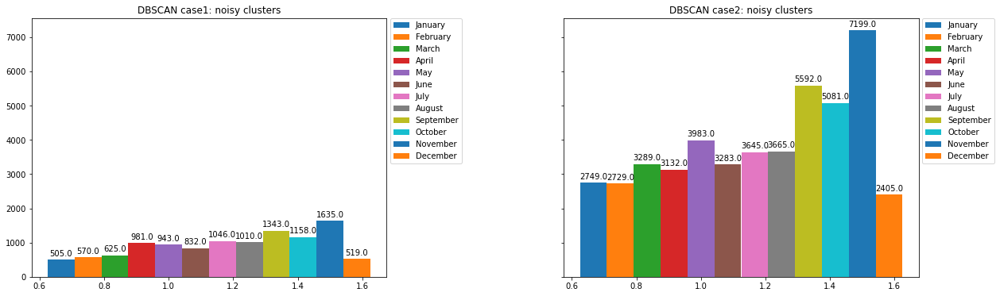

In [999]:
months_bar = [[] for _ in range(4)]

for i in range(8,20):
    months_bar[0].append(cs_clusters[cs_clusters.DBS1 == 0][cs_cat.columns[i]].sum())
    months_bar[1].append(cs_clusters[cs_clusters.DBS2 == 0][cs_cat.columns[i]].sum())
    months_bar[2].append(cs_clusters[cs_clusters.DBS1 == -1][cs_cat.columns[i]].sum())
    months_bar[3].append(cs_clusters[cs_clusters.DBS2 == -1][cs_cat.columns[i]].sum())
        
f, axs = plt.subplots(nrows=1, ncols=2, figsize=(20,6), sharey=True)
f.subplots_adjust(wspace=0.5)

for j in range(2):
    for i in range(8,20):
        point = (1/len(months_bar[j]) * i)
        autolabel(axs[j].bar(point, months_bar[j][i-8], 1/len(months_bar[j]), label=cs_cat.columns[i]), j)
    axs[j].legend(bbox_to_anchor=(1.01, 1), loc='upper left', borderaxespad=0.)
    axs[j].set_title('DBSCAN case' + str(j+1) + ': non-noisy clusters')
    
f, axs = plt.subplots(nrows=1, ncols=2, figsize=(20,6), sharey=True)
f.subplots_adjust(wspace=0.5)

for j in range(2):
    for i in range(8,20):
        point = (1/len(months_bar[j+2]) * i)
        autolabel(axs[j].bar(point, months_bar[j+2][i-8], 1/len(months_bar[j+2]), label=cs_cat.columns[i]), j)
    axs[j].legend(bbox_to_anchor=(1.01, 1), loc='upper left', borderaxespad=0.)
    axs[j].set_title('DBSCAN case' + str(j+1) + ': noisy clusters')   

In [1000]:
cs_clusters

,I,Iu,Imax,E,Stot,Smax,Country,Monday,Tuesday,Wednesday,...,October,November,December,Weekday,Month,C3,C5,C8,DBS1,DBS2
I,,,,,,,,,,,,,,,,,,,,,
304,304,28,204,4.807355,728.39,560.40,United Kingdom,0.0,13.0,3.0,...,0.0,3.0,0.0,Tuesday,February,2,3,0,0,0
435,435,24,112,4.305245,1107.51,293.14,United Kingdom,4.0,37.0,6.0,...,0.0,0.0,0.0,Tuesday,September,2,1,0,0,0
52,52,8,52,3.000000,185.30,185.30,United Kingdom,0.0,8.0,0.0,...,0.0,0.0,0.0,Tuesday,January,1,2,2,0,0
256,256,23,112,4.483856,485.08,215.76,United Kingdom,0.0,17.0,0.0,...,8.0,0.0,0.0,Tuesday,June,2,1,2,0,0
206,206,21,106,4.349649,373.54,210.24,United Kingdom,0.0,13.0,10.0,...,0.0,0.0,0.0,Tuesday,January,1,1,2,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12,12,1,12,0.000000,10.20,10.20,United Kingdom,0.0,0.0,0.0,...,0.0,0.0,0.0,Friday,August,1,2,7,0,0
69,69,8,69,3.000000,113.54,113.54,United Kingdom,0.0,0.0,0.0,...,0.0,0.0,0.0,Friday,August,1,2,7,0,0
194,194,17,194,4.087463,320.70,320.70,United Kingdom,0.0,0.0,0.0,...,0.0,0.0,0.0,Friday,August,2,1,0,0,0


### DBSCAN conclusions

#### Pros
- Deciding *a priori* the number of clusters is not needed: the algorithm is able to discover them by itself.
- Robust wrt noise: it detects noisy points and assigns them a -1 label (instead in K-Means they're assigned to the closest centroid)
- Is able to find clusters with any shape (not only globular / spherical shape as K-Means does), because there is no notion of *centroids* here.

#### Cons

Density-based clustering methods are somewhat **harder to tune** compared to parametric clustering methods like K-Means. Things like the epsilon parameter for DBSCAN are less intuitive to reason about compared to the number of clusters parameter for K-Means, so it’s more difficult to pick good initial parameter values for these algorithms.

As a matter of fact, we had to do a lot of executions in order to tune parameters in a sufficient good way (see above *Parameter tuning*).

Another limit of DBSCAN algorithm is that it **not able to not recognize different densities**. From the scatter plots above it is easy to see that DBSCAN does not works very well in varying-densities environment.

For this reason we had to distinguish between two different results interpretation.

# Clustering analysis by hierarchical clustering

Hierarchical approaches to clustering are useful when having an nested structure among the cluster is a necessity. The main drawbacks of such approaches are the time and space performances and, for this reasons, they're usually combined with other clustering analysis like k-means.

The hierarchy of clusters can be visualized with a dendogram: a tree structure where the horizontal lines represent the merging of two nodes, or clusters, and the vertical line provides information regarding the distance (or similarity) between said elements. By the end of the agglomerative bottom-up process, the dendrogram ends up displaying the whole merging process leading to a single universal cluster. Every number of clusters can be obtained by cutting the tree at the right level / height.

**About distances**

The first step is to compute the matrix accounting the distances among each of the point in our dataframe. Said computing can be performed by the **scipy** function **pdist** or by specifying the a particulare metric as a parameter of the **AgglomerativeClustering** class of **Sklearn**. 

Both alternatives are able to compute distances with respect to several well-known metrics or even custom ones specifically defined by the user. 
For the sake of this analysis, and due to the rich presence of continuous numerical data, we are going to select the **Euclidean distance** as our metrics of choice.

**About linkage**

The second step is usually to chose a linkage method, that is chosing *how* the computation of the aforementioned distance is going to be performed. Again, the list of methods for linkage contains several choices, mainly leading to:
- Max / Complete-Linkage
- Min / Single-linkage
- Average-linkage
- Ward-linkage

Throughout this notebook we are going to analize and discuss the application of these main methods while highlighting, and assessing, their principal advantages and drawbacks.  

**Optimal value of k in hierarchical clustering**

Hiearchical approaches don't usually provide, at least explicity, an ideal number of clusters. 
Said parameter can be inferred, other than via familiar methods as the elbow and Silhouette plots, by analysing the dendrogram describing our hierarchy.    

The best "cut" for the dendrogram is placed at a height where the line can traverse the maximum distance without intersecting an horizontal line representing a merging point. Said method, however, is not perfect and the selection of an optimal k is often influenced by the characteristics of the dataset or the application of the clustering itself. Also, the **dendrogram** function from **scipy**, thanks to the **color_threshold** parameter, is able to highlight with different colors the links connecting nodes particularly close to each other, hence providing a powerful insight regarding the main clusters whitin the dataset.  

For the sake of this analysis we are going to highlight the optimal cut on each dendrogram while combining said study with considerations regarding the Silhouette score of the resulting clusters.

In [141]:
from scipy.cluster.hierarchy import dendrogram, linkage, cut_tree
from scipy.spatial.distance import pdist

from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics import silhouette_score

In [142]:
def plot_dendrogram(model, **kwargs):
    # Create linkage matrix and then plot the dendrogram

    # create the counts of samples under each node
    counts = np.zeros(model.children_.shape[0])
    n_samples = len(model.labels_)
    for i, merge in enumerate(model.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1  # leaf node
            else:
                current_count += counts[child_idx - n_samples]
        counts[i] = current_count

    linkage_matrix = np.column_stack([model.children_, model.distances_,
                                      counts]).astype(float)

    # Plot the corresponding dendrogram
    dendrogram(linkage_matrix, **kwargs)

In [143]:
max_k = 10
colors = ['tab:blue', 'tab:orange', 'tab:green', 'tab:red', 'tab:purple', 'tab:brown', 'tab:pink', 'tab:gray', 'tab:olive', 'tab:cyan']
visual_labels = []
for j in range(1, max_k):
        visual_labels.append('Cluster ' + str(j))

### The Nearest Point Algorithm: single-linkage
The proximity of two clusters is based on the proximity of the two closest points. 
<br>It tends to perform similarly to DBSCAN. 

The main advantage of this approach is being able to recognize non-elliptical clusters however, being it also sensitive to noise and outliers, we can expect otherwise unrelated clusters being clumped together by one of these points. 

In [144]:
# We want to compute the entire tree
model_single = AgglomerativeClustering(distance_threshold=0, n_clusters=None, affinity='euclidean', linkage='single').fit(cs_norm_minmax) 

#### Dendrogram and Silhouette scores

Text(0, 0.5, 'Distance')

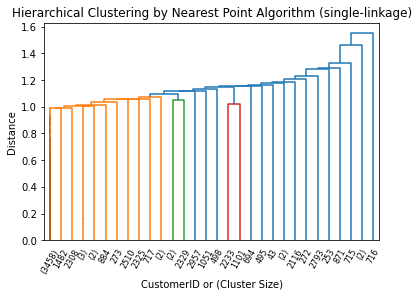

In [145]:
# We plot the dendrogram
plot_dendrogram(model_single, truncate_mode='lastp', p=30, leaf_rotation=60, leaf_font_size = 8, show_contracted=True)
plt.title('Hierarchical Clustering by Nearest Point Algorithm (single-linkage)')
plt.xlabel('CustomerID or (Cluster Size)')
plt.ylabel('Distance')

Here the dendrogram seems to suggest the presence of two main clusters, the first (orange in the graph) containing most of the dataset population and the second made up by mostly unrelated points. 

Considering two clusters is a proposition that the Silhouette graph seems to support and therefore we proceed with the characterization of such groups.

#### Characterization of the clusters for n_clusters = 2
The differences between the two clusters' dimension is far too wide to permit any meaningful visualization. Such behaviour however is expected due to the 

In [146]:
n_c=2
model_single = AgglomerativeClustering(n_clusters=n_c, affinity='euclidean', linkage='single').fit(cs_norm_minmax) 

##### Clusters distributions: Pie Chart and Histogram

<BarContainer object of 2 artists>

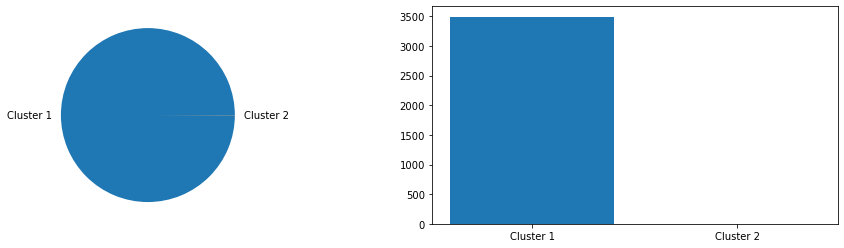

In [147]:
hist, bins = np.histogram(model_single.labels_, bins=range(0, len(set(model_single.labels_)) + 1))
hist, bins
f, axs = plt.subplots(nrows=1, ncols=2, figsize=(16,4))
axs[0].pie(hist, labels=visual_labels[0:n_c])
axs[1].bar(list(range(1, n_c+1)), hist, color=colors[0:n_c], tick_label=visual_labels[0:n_c])

##### Cluster Visualization via scatter plots

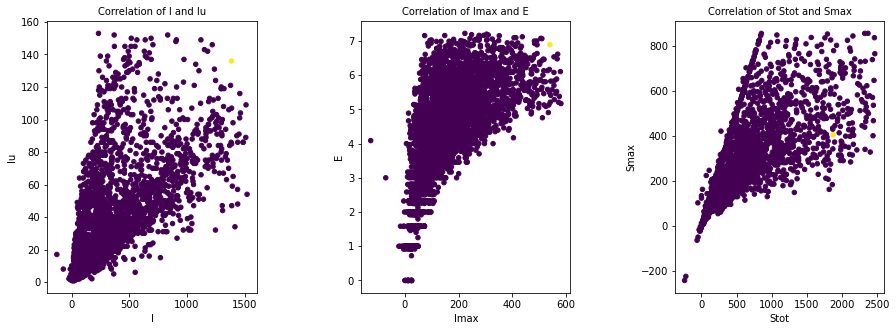

In [148]:
# scatter plots with centroids
f, axs = plt.subplots(nrows=1, ncols=3, figsize=(15,5))
f.subplots_adjust(wspace=0.5)
for i in range(0,len(cs_no_out.columns), 2):
        axs[int(i/2)].scatter(cs_no_out[cs_no_out.columns[i]], cs_no_out[cs_no_out.columns[i+1]], c=model_single.labels_, s=20)
        axs[int(i/2)].set_title('Correlation of ' + cs_no_out.columns[i] + ' and ' + cs_no_out.columns[i+1], fontdict={'fontsize': 'medium'})
        axs[int(i/2)].set_xlabel(cs_no_out.columns[i], fontdict={'fontsize': 'medium'})
        axs[int(i/2)].set_ylabel(cs_no_out.columns[i+1], fontdict={'fontsize': 'medium'})

### The Farthest Point Algorithm: complete-linkage
It is based on the complete (Max) linkage and, as mentioned in the section regarding K-means, it tends to perform similarly to said centroid based algorithm. 

Expectations:
- it is less susceptible to noise and outliers and thus to the "bridge problem" common of the other methods like the single linkage
- it tends to prefer globular clusters 
- it tends to break large clusters

In [149]:
# We want to compute the entire tree
model_complete = AgglomerativeClustering(distance_threshold=0, n_clusters=None, affinity='euclidean', linkage='complete').fit(cs_norm_minmax) 

#### Dendrogram and Silhouette scores

Text(0, 0.5, 'Distance')

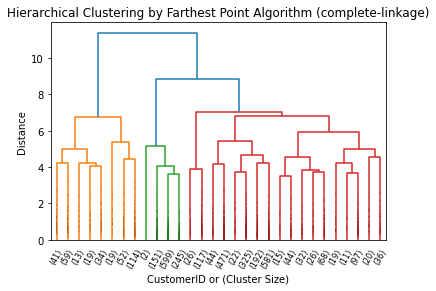

In [150]:
# We plot the dendrogram
plot_dendrogram(model_complete, truncate_mode='lastp', p=30, leaf_rotation=60, leaf_font_size = 8, show_contracted=True)
plt.title('Hierarchical Clustering by Farthest Point Algorithm (complete-linkage)')
plt.xlabel('CustomerID or (Cluster Size)')
plt.ylabel('Distance')

Here the dendrogram seems to suggest the presence of three main clusters. 
The Silhouette graph instead seems to support the idea of six clusters and therefore we proceed with the characterization of both clustering.

#### Characterization of the clusters 

In [151]:
n_c = 3
model_complete = AgglomerativeClustering(n_clusters=n_c, affinity='euclidean', linkage='complete').fit(cs_norm_minmax) 

<BarContainer object of 3 artists>

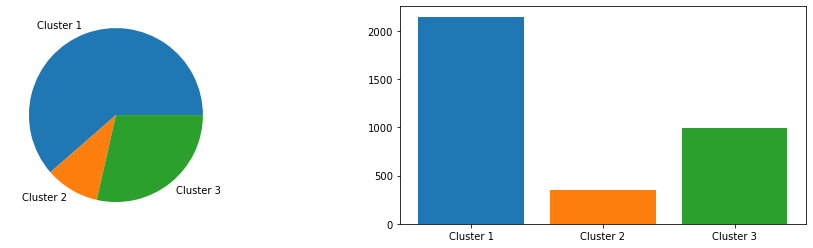

In [152]:
hist, bins = np.histogram(model_complete.labels_, bins=range(0, len(set(model_complete.labels_)) + 1))
hist, bins
f, axs = plt.subplots(nrows=1, ncols=2, figsize=(16,4))
axs[0].pie(hist, labels=visual_labels[0:n_c])
axs[1].bar(list(range(1, n_c+1)), hist, color=colors[0:n_c], tick_label=visual_labels[0:n_c])

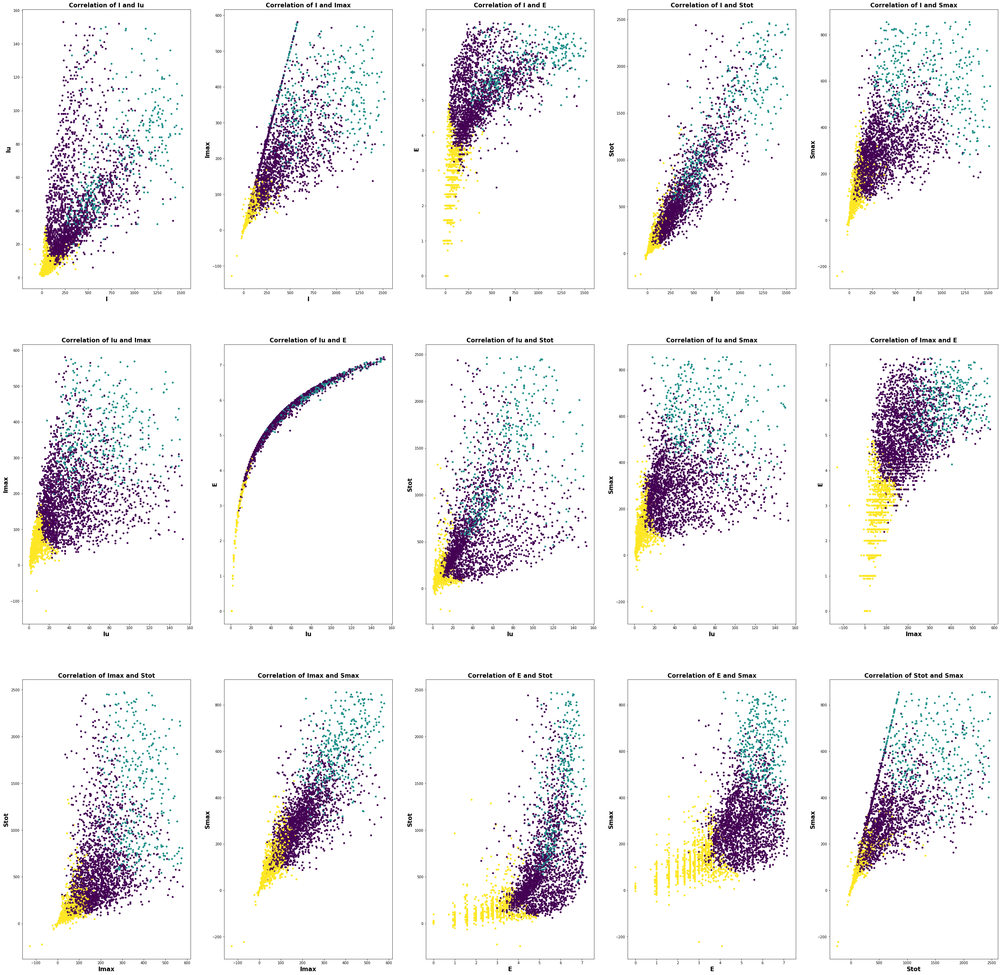

In [153]:
# scatter plots with centroids
f, axs = plt.subplots(nrows=3, ncols=5, figsize=(50,50))
index = 0
for i in range(0,len(cs_no_out.columns)):
    for j in range(i+1,len(cs_no_out.columns)):
        axs[int(index/5)][index%5].scatter(cs_no_out[cs_no_out.columns[i]], cs_no_out[cs_no_out.columns[j]], c=model_complete.labels_, s=20)
        axs[int(index/5)][index%5].set_title('Correlation of ' + cs_no_out.columns[i] + ' and ' + cs_no_out.columns[j], fontdict={'fontsize': 'xx-large', 'fontweight' : 'bold'})
        axs[int(index/5)][index%5].set_xlabel(cs_no_out.columns[i], fontdict={'fontsize': 'xx-large', 'fontweight' : 'bold'})
        axs[int(index/5)][index%5].set_ylabel(cs_no_out.columns[j], fontdict={'fontsize': 'xx-large', 'fontweight' : 'bold'})
        index = index + 1

### The UPGMA Algorithm: average-linkage
It stands as a trade-off between the complete and single linkages. The proximity of two clusters is the average of the pairwise proximity between the points of the two clusters.

Expectations:
- As the complete linkage, it is less susceptible to noise and outliers
- Again, it also tends to prefer globular clusters

In [154]:
# We want to compute the entire tree
model_average = AgglomerativeClustering(distance_threshold=0, n_clusters=None, affinity='euclidean', linkage='average').fit(cs_norm_minmax) 

#### Dendrogram and Silhouette scores

Text(0, 0.5, 'Distance')

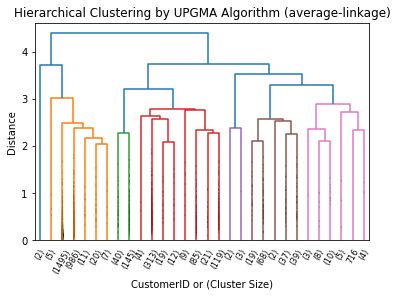

In [155]:
# We plot the dendrogram
plot_dendrogram(model_average, truncate_mode='lastp', p=30, leaf_rotation=60, leaf_font_size = 8, show_contracted=True)
plt.title('Hierarchical Clustering by UPGMA Algorithm (average-linkage)')
plt.xlabel('CustomerID or (Cluster Size)')
plt.ylabel('Distance')

In [156]:
k = 6

In [157]:
model_average = AgglomerativeClustering(n_clusters=k, affinity='euclidean', linkage='average').fit(cs_norm_minmax)

<BarContainer object of 6 artists>

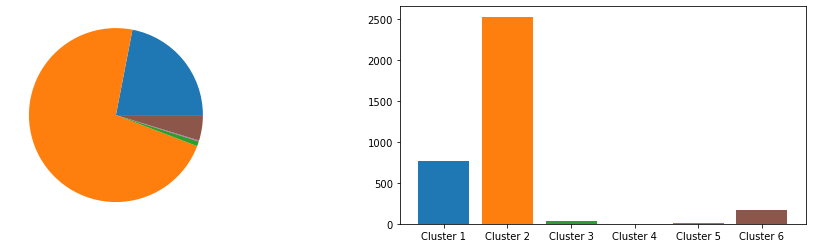

In [158]:
hist, bins = np.histogram(model_average.labels_, bins=range(0, len(set(model_average.labels_)) + 1))
hist, bins
f, axs = plt.subplots(nrows=1, ncols=2, figsize=(16,4))
#axs[0].pie(hist, labels=visual_labels[0:k])
axs[0].pie(hist)
axs[1].bar(list(range(1, k+1)), hist, color=colors[0:k], tick_label=visual_labels[0:k])

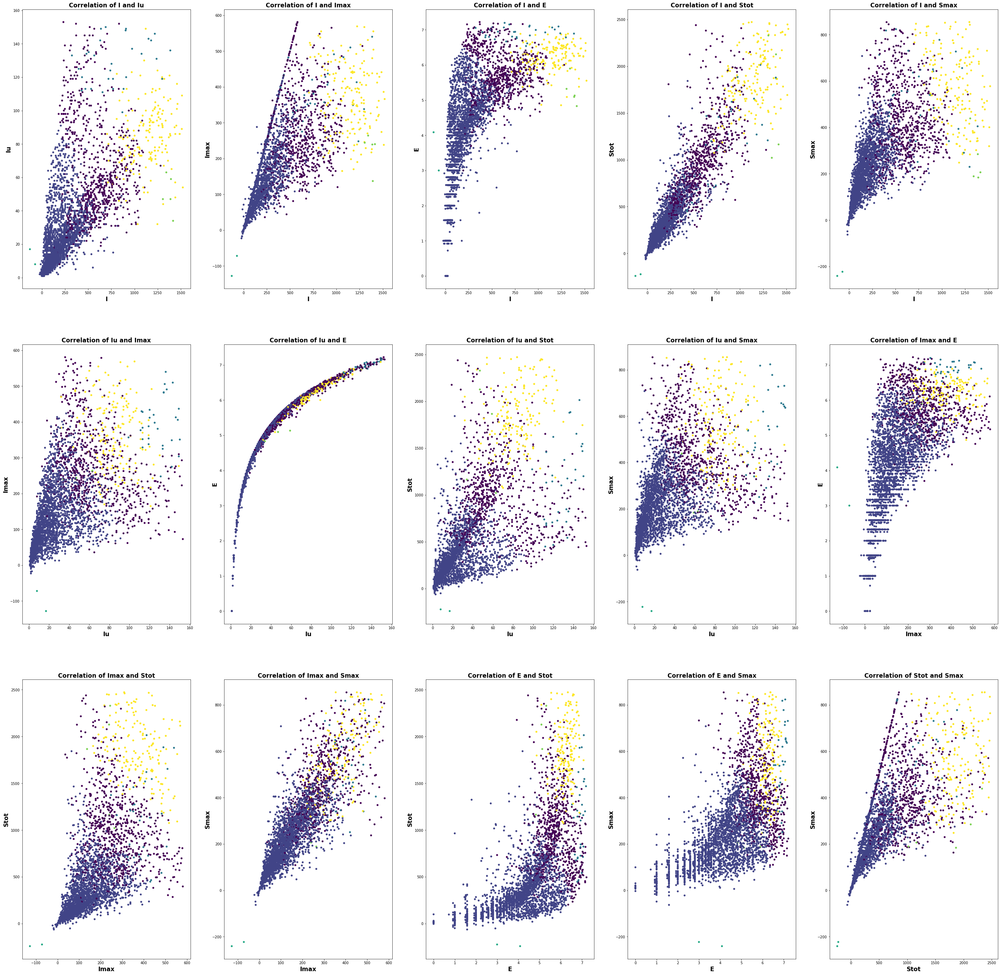

In [159]:
# scatter plots with centroids
f, axs = plt.subplots(nrows=3, ncols=5, figsize=(50,50))
index = 0
for i in range(0,len(cs_no_out.columns)):
    for j in range(i+1,len(cs_no_out.columns)):
        axs[int(index/5)][index%5].scatter(cs_no_out[cs_no_out.columns[i]], cs_no_out[cs_no_out.columns[j]], c=model_average.labels_, s=20)
        axs[int(index/5)][index%5].set_title('Correlation of ' + cs_no_out.columns[i] + ' and ' + cs_no_out.columns[j], fontdict={'fontsize': 'xx-large', 'fontweight' : 'bold'})
        axs[int(index/5)][index%5].set_xlabel(cs_no_out.columns[i], fontdict={'fontsize': 'xx-large', 'fontweight' : 'bold'})
        axs[int(index/5)][index%5].set_ylabel(cs_no_out.columns[j], fontdict={'fontsize': 'xx-large', 'fontweight' : 'bold'})
        index = index + 1

### The Incremental Algorithm: ward-linkage
It stands as the hierarchical analogue of K-means and, like the former, it is a centroid based approach with a particular interest in the minimization of the SSE values associated with each cluster.


In [160]:
 # We want to compute the entire tree
model_ward = AgglomerativeClustering(distance_threshold=0, n_clusters=None, affinity='euclidean', linkage='ward').fit(cs_norm_minmax)

#### Dendrogram and Silhouette scores

Text(0, 0.5, 'Distance')

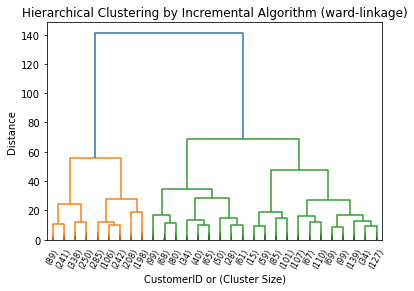

In [161]:
# We plot the dendrogram
plot_dendrogram(model_ward, truncate_mode='lastp', p=30, leaf_rotation=60, leaf_font_size = 8, show_contracted=True)
plt.title('Hierarchical Clustering by Incremental Algorithm (ward-linkage)')
plt.xlabel('CustomerID or (Cluster Size)')
plt.ylabel('Distance')

In [162]:
k = 2

In [163]:
model_ward = AgglomerativeClustering(n_clusters=k, affinity='euclidean', linkage='ward').fit(cs_norm_minmax) # We want to compute the tree

<BarContainer object of 2 artists>

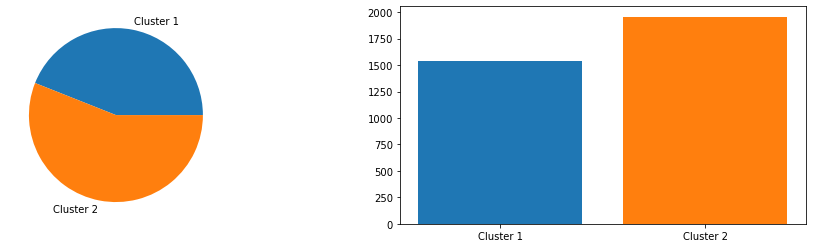

In [164]:
hist, bins = np.histogram(model_ward.labels_, bins=range(0, len(set(model_ward.labels_)) + 1))
hist, bins
f, axs = plt.subplots(nrows=1, ncols=2, figsize=(16,4))
axs[0].pie(hist, labels=visual_labels[0:k])
axs[1].bar(list(range(1, k+1)), hist, color=colors[0:k], tick_label=visual_labels[0:k])

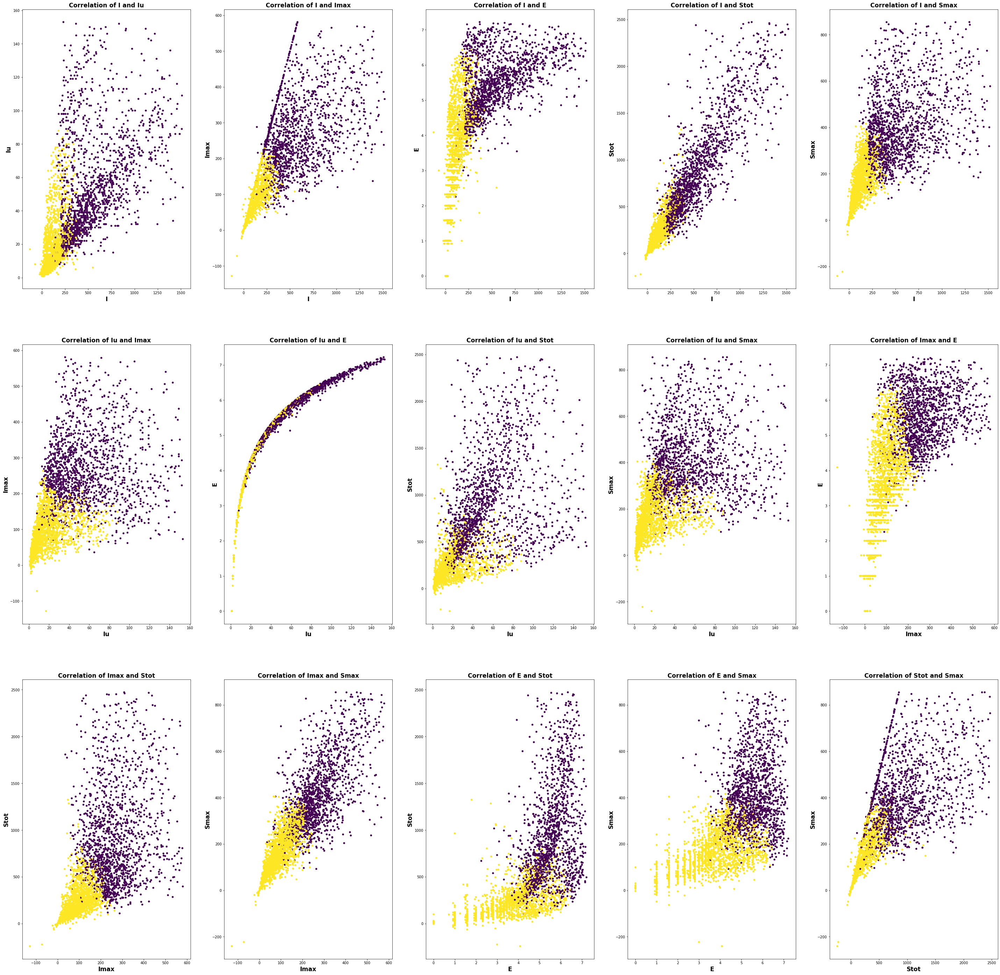

In [165]:
# scatter plots with centroids
f, axs = plt.subplots(nrows=3, ncols=5, figsize=(50,50))
index = 0
for i in range(0,len(cs_no_out.columns)):
    for j in range(i+1,len(cs_no_out.columns)):
        axs[int(index/5)][index%5].scatter(cs_no_out[cs_no_out.columns[i]], cs_no_out[cs_no_out.columns[j]], c=model_ward.labels_, s=20)
        axs[int(index/5)][index%5].set_title('Correlation of ' + cs_no_out.columns[i] + ' and ' + cs_no_out.columns[j], fontdict={'fontsize': 'xx-large', 'fontweight' : 'bold'})
        axs[int(index/5)][index%5].set_xlabel(cs_no_out.columns[i], fontdict={'fontsize': 'xx-large', 'fontweight' : 'bold'})
        axs[int(index/5)][index%5].set_ylabel(cs_no_out.columns[j], fontdict={'fontsize': 'xx-large', 'fontweight' : 'bold'})
        index = index + 1

# Final evaluation and comparison

# (Optional) Alternative clustering techniques